In [63]:
from IMPA.dataset.data_loader import CellDataLoader
from IMPA.solver import IMPAmodule
from omegaconf import OmegaConf
from tqdm import tqdm
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
import pandas as pd
import os
import torch
from IMPA.dataset.data_utils import CustomTransform
import yaml 
from IMPA.eval.gan_metrics.fid import *
import seaborn as sns
from IMPA.eval.gan_metrics.density_and_coverage import compute_d_c

In [214]:
class Args:
    def __init__(self, dictionary):
        self.__dict__ = dictionary

    def __getattr__(self, key):
        if key in self.__dict__:
            return self.__dict__[key]
        else:
            raise AttributeError(f"'DictToObject' object has no attribute '{key}'")

    def __call__(self, key):
        return self.__getattr__(key)

def t2np(t, batch=True):
    if batch:
        return ((t.permute(0,2, 3, 1) + 1) / 2).clamp(0,1).cpu().numpy()
    else:
        return ((t.permute(1,2,0) + 1) / 2).clamp(0,1).cpu().numpy()

def show_images_by_groups(image_folder, df, group, unique_ids, n_to_plot, plot=True, save=False):
    if save:
        transform = CustomTransform(augment=True, normalize=True)
        image_dict = {}
    for id in unique_ids:
        print("Pert id", id)
        if save:
            image_dict[id] = []
        df_id = df.loc[df[group]==id]
        for i, key in enumerate(df_id.SAMPLE_KEY):
            plate, well, view, cell_no = key.split("_")
            image_path = image_folder / plate / f"{well}_{view}" / f"{well}_{view}_{cell_no}.npy"
            if save:
                img = transform(torch.from_numpy(np.load(image_path)).to(torch.float).permute(2,0,1))
                img = t2np(img, batch=False)
                if save:
                    image_dict[id].append(img)
            else:
                img=np.load(image_path)

            if plot:
                print("Plate id", plate)
                plt.figure(figsize=(1.5,1.5))
                plt.imshow(img[:, :, [0,1,4]])
                plt.axis("off")
                plt.show()
            
            if i == n_to_plot:
                break
                
        if save:
            image_dict[id] = np.stack(image_dict[id], axis=0)

    if save:
        return image_dict
        
def compute_fid(fake_domain, true_domain):
    fake_domain = torch.tensor(fake_domain).permute(0, 3, 1, 2).cuda()
    true_domain = torch.tensor(true_domain).permute(0, 3, 1, 2).cuda()
    fake_dataset = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(fake_domain), batch_size=64)
    true_dataset = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(true_domain), batch_size=64)
    fid = cal_fid(fake_dataset, true_dataset, 2048, True, [0,1,4])
    fid = fid/100
    return fid

def compute_d_and_c(fake_domain, true_domain):
    fake_dataset_flat = fake_domain.view(fake_domain.shape[0], -1)
    true_dataset_flat = true_domain.view(true_domain.shape[0], -1)
    K = 10   # Smaller value for bbbc025 and recursion datasets because each class is smaller 
    d_and_c = compute_d_c(true_dataset_flat.cpu().numpy(), fake_dataset_flat.cpu().numpy(), K)
    return d_and_c

In [215]:
with open("/home/icb/alessandro.palma/environment/IMPA/IMPA/config_hydra/config/cpg0000_multimodal_leaveout.yaml", "rb") as file:
    config_dict = yaml.safe_load(file)
    
args = OmegaConf.create(config_dict)
dest_dir = "/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/experiments/20240314_ae2fd4f5-9473-4381-b65e-4e8af89e5cd2_cpg0000_multimodal_leaveout"

In [174]:
image_folder = Path("/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/cpg0000/cpg0000_u2os_normalized_segmented_large_transported")

In [175]:
dataloader = CellDataLoader(args)

{'CRISPR': 328, 'Compound': 1224, 'ORF': 456}


In [176]:
solver = IMPAmodule(args, dest_dir, dataloader)
solver._load_checkpoint(100)
solver = solver.cuda()

Number of parameters in generator: 24319877
Number of parameters in style_encoder: 14330624
Number of parameters in discriminator: 14663561
Number of parameters in mapping_network: 132544
Initializing embedding_matrix...
Initializing generator...
Initializing style_encoder...
Initializing discriminator...
Initializing mapping_network...
IMPAmodule(
  (embedding_matrix): ModuleList(
    (0): Embedding(281, 328)
    (1): Embedding(277, 1224)
    (2): Embedding(155, 456)
  )
  (generator): DataParallel(
    (module): Generator(
      (from_rgb): Conv2d(5, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (encode): ModuleList(
        (0): ResBlk(
          (actv): LeakyReLU(negative_slope=0.2)
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (norm1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (norm

In [177]:
train_dataloader = dataloader.train_dataloader()
val_dataloader = dataloader.val_dataloader()

# Read compound document

In [178]:
metadata_cpg0000 = pd.read_csv("/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/cpg0000/metadata/metadata_large_gene2vec.csv",
                              index_col=0)
metadata_cpg0000_trt = metadata_cpg0000.loc[metadata_cpg0000.STATE=="trt"]
metadata_cpg0000_cpd = metadata_cpg0000_trt.drop_duplicates(subset="BROAD_SAMPLE", keep="last").sort_values(by="BROAD_SAMPLE")
gene_unique = np.unique(metadata_cpg0000_cpd.GENE)
metadata_cpg0000_cpd = metadata_cpg0000_cpd.set_index("BROAD_SAMPLE")

In [179]:
crispr_embeddings_path= args.embedding_path['CRISPR']
compound_embeddings_path = args.embedding_path['Compound']

In [180]:
crispr_embeddings = pd.read_csv(crispr_embeddings_path).set_index("BROAD_SAMPLE")
compound_embeddings = pd.read_csv(compound_embeddings_path).set_index("BROAD_SAMPLE")

In [181]:
ood_set =args["ood_set"]
ood_cpd = []
ood_crispr = []

for pert in ood_set:
    if "-" in pert:
        ood_cpd.append(pert)
    else:
        ood_crispr.append(pert)

In [182]:
held_out_cpd_embeddings = compound_embeddings.loc[ood_cpd]
held_out_cr_embeddings = crispr_embeddings.loc[ood_crispr]

In [183]:
held_out_embeddings = {"Compound": held_out_cpd_embeddings, "CRISPR": held_out_cr_embeddings}

In [184]:
transf_images = {}
real_images = {}
genes_heldout = []
pert_id_heldout = []

with torch.no_grad():
    for pert_type in tqdm(held_out_embeddings):
        i = 1 if pert_type=="Compound" else 0
        for batch in train_dataloader:
            X_ctr = batch["X"][0]
            for pert in held_out_embeddings[pert_type].index:
                pert_id_heldout.append(np.unique(metadata_cpg0000.loc[metadata_cpg0000.BROAD_SAMPLE==pert].CPD_NAME)[0])
                genes_heldout.append(np.unique(metadata_cpg0000.loc[metadata_cpg0000.BROAD_SAMPLE==pert].GENE)[0])
                emb = torch.Tensor(held_out_embeddings[pert_type].loc[pert]).cuda().unsqueeze(0).repeat(X_ctr.shape[0],1)
                X_generated_stack = []
                for _ in range(5):
                    z = torch.randn(X_ctr.shape[0], 1, args.z_dimension).mean(1).cuda()
                    
                    # Get random vec
                    y = torch.cat([emb, z], dim=1)
                    y = solver.nets.mapping_network(y, None, i)
                    _, X_generated = solver.nets.generator(X_ctr, y)
                    X_generated_stack.append(X_generated)

                X_generated_stack = torch.cat(X_generated_stack, dim=3)
                transf_images[pert] = t2np(X_generated_stack.detach().cpu())
                real_images[pert] = t2np(X_ctr.detach().cpu())
            break

100%|██████████| 2/2 [00:14<00:00,  7.41s/it]


In [185]:
real_images.keys()

dict_keys(['BRD-A65597028-003-08-1', 'BRD-K90747162-001-01-4', 'BRD-K01824976-300-02-9', 'BRD-A22713669-001-04-3', 'BRD-K76674262-001-03-3', 'BRD-A10188456-001-04-9', 'BRD-K09295674-001-09-8', 'BRD-K18131774-001-18-4', 'BRD-K14560436-001-01-4', 'BRD-K43570081-001-02-4', 'BRD-K54330070-001-19-6', 'BRD-K40109029-001-02-9', 'BRD-K00259736-001-16-4', 'BRD-K03601870-001-01-2', 'BRD-K18895904-001-16-1', 'BRD-K15502390-001-20-9', 'BRD-A20697603-001-07-2', 'BRD-A08187463-001-12-9', 'BRD-K03109492-001-02-2', 'BRDN0001147538', 'BRDN0001479055', 'BRDN0001479262', 'BRDN0001145239', 'BRDN0001144958', 'BRDN0001481569', 'BRDN0001145324', 'BRDN0001481176', 'BRDN0001065244', 'BRDN0001485334', 'BRDN0001147209', 'BRDN0001490153', 'BRDN0001493988', 'BRDN0001487761', 'BRDN0001147450'])

BRD-A65597028-003-08-1
gene --> ADRA2B
compound --> RX-821002
real


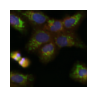

transf


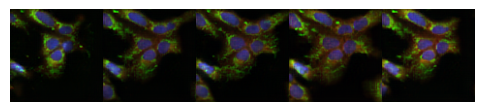

real


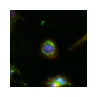

transf


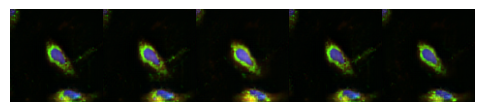

real


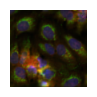

transf


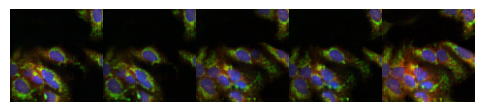

real


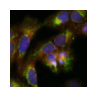

transf


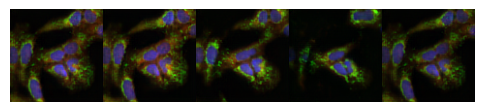

real


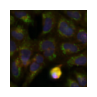

transf


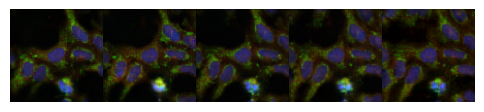

real


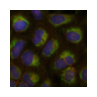

transf


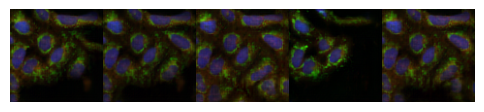

real


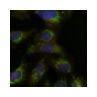

transf


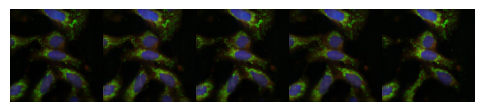

real


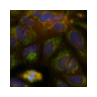

transf


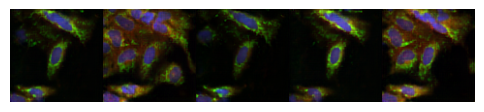

real


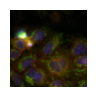

transf


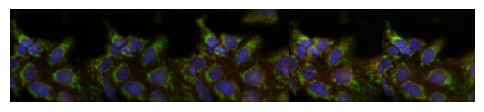

real


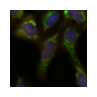

transf


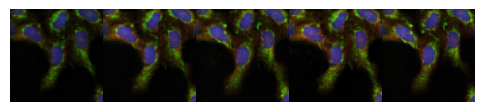

BRD-K90747162-001-01-4
gene --> FLT3
compound --> KG-5
real


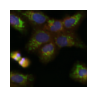

transf


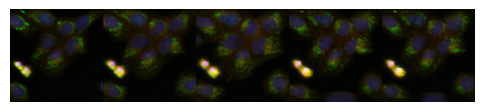

real


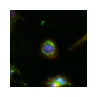

transf


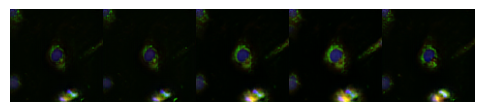

real


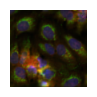

transf


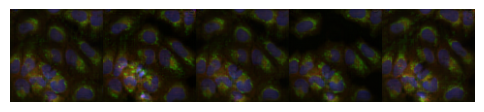

real


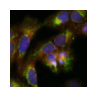

transf


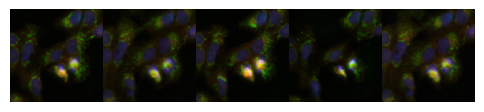

real


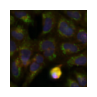

transf


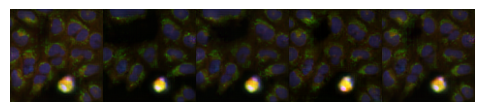

real


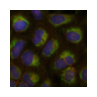

transf


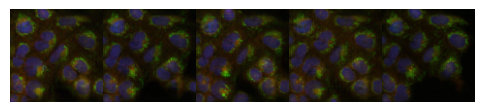

real


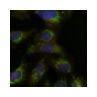

transf


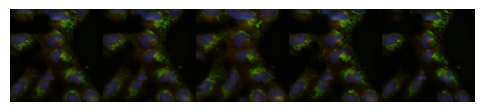

real


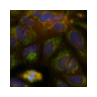

transf


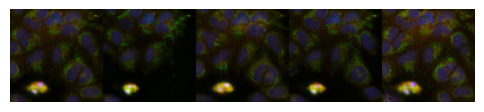

real


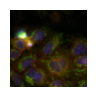

transf


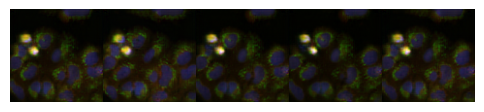

real


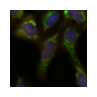

transf


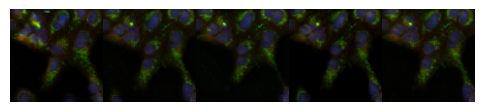

BRD-K01824976-300-02-9
gene --> RPL23A
compound --> puromycin
real


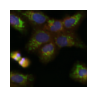

transf


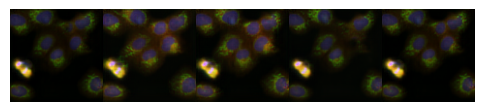

real


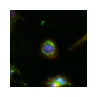

transf


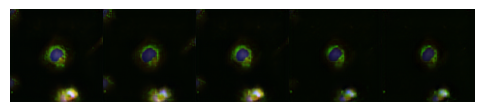

real


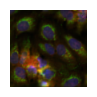

transf


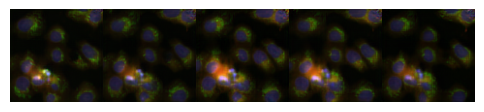

real


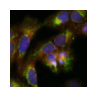

transf


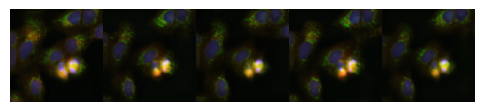

real


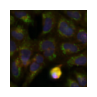

transf


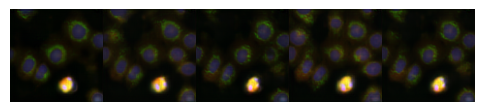

real


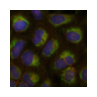

transf


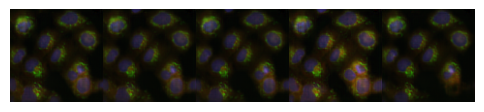

real


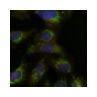

transf


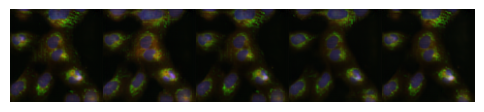

real


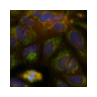

transf


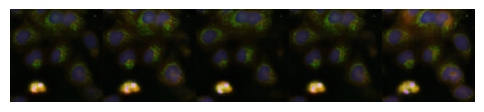

real


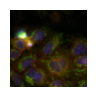

transf


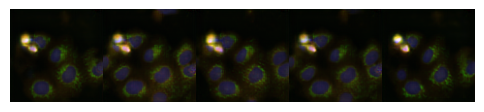

real


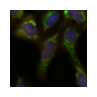

transf


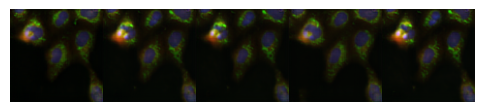

BRD-A22713669-001-04-3
gene --> PTPN2
compound --> BVT-948
real


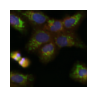

transf


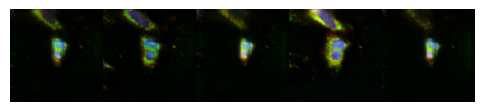

real


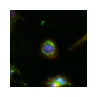

transf


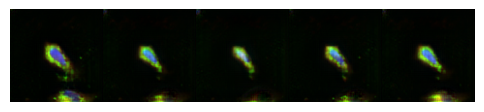

real


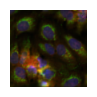

transf


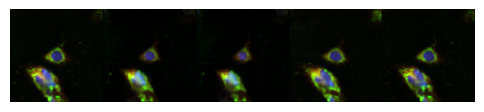

real


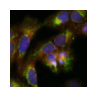

transf


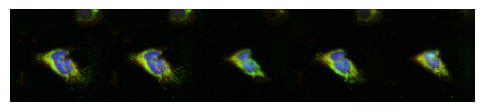

real


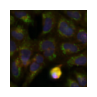

transf


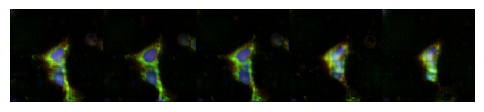

real


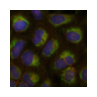

transf


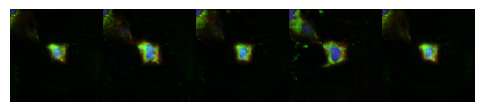

real


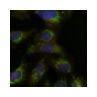

transf


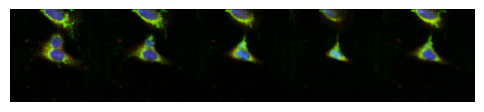

real


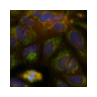

transf


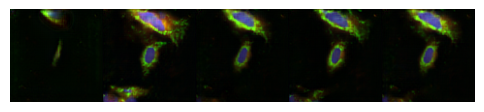

real


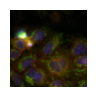

transf


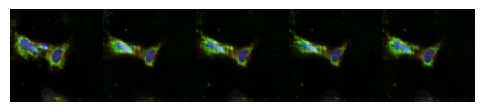

real


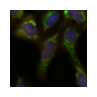

transf


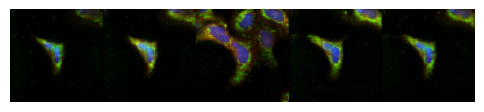

BRD-K76674262-001-03-3
gene --> RPL3
compound --> homoharringtonine
real


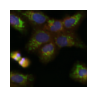

transf


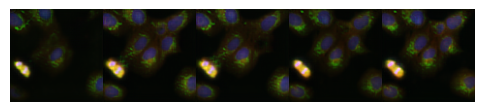

real


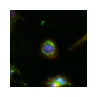

transf


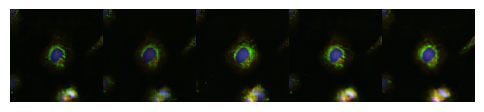

real


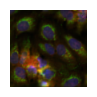

transf


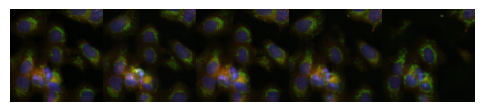

real


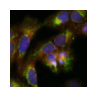

transf


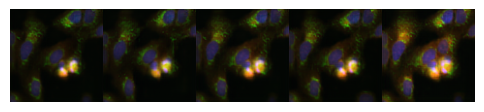

real


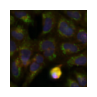

transf


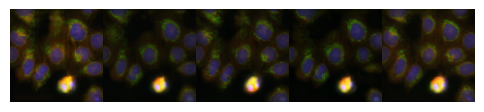

real


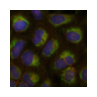

transf


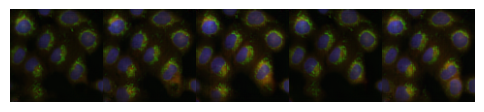

real


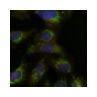

transf


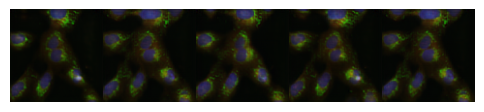

real


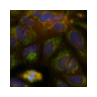

transf


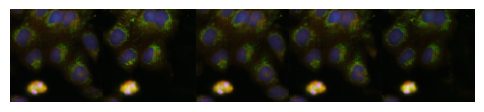

real


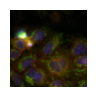

transf


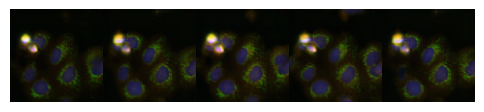

real


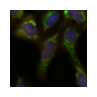

transf


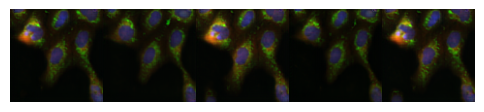

BRD-A10188456-001-04-9
gene --> ANXA1
compound --> dexamethasone
real


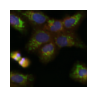

transf


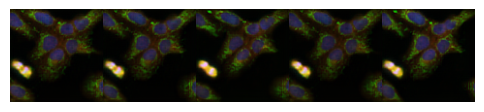

real


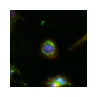

transf


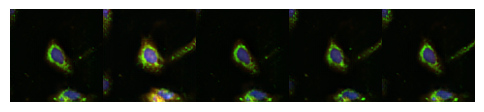

real


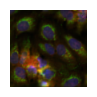

transf


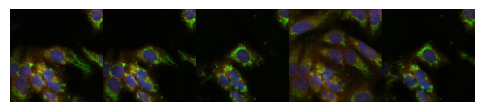

real


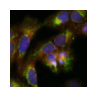

transf


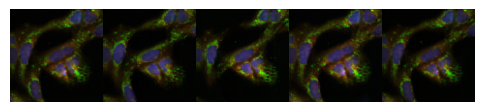

real


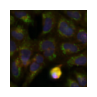

transf


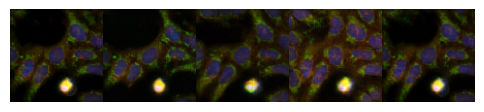

real


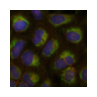

transf


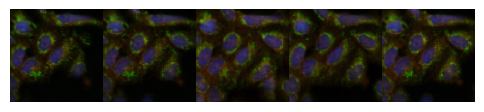

real


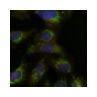

transf


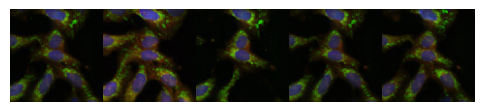

real


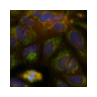

transf


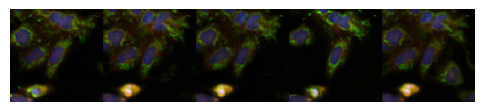

real


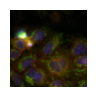

transf


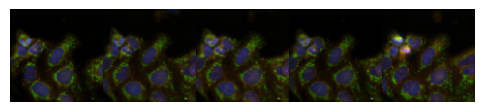

real


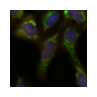

transf


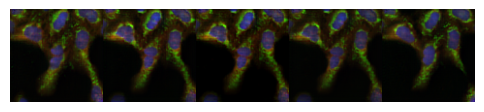

BRD-K09295674-001-09-8
gene --> CA14
compound --> carzenide
real


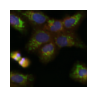

transf


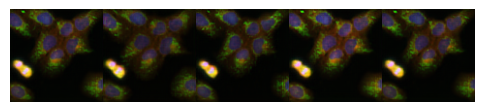

real


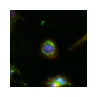

transf


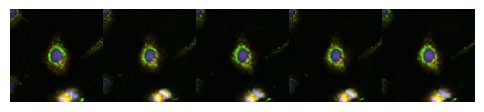

real


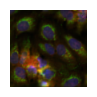

transf


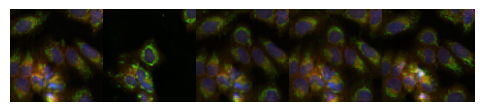

real


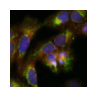

transf


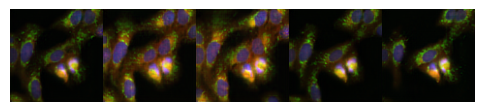

real


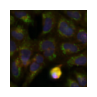

transf


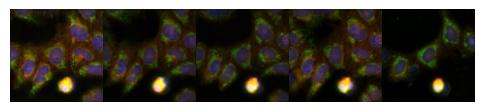

real


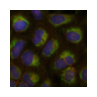

transf


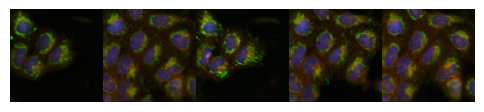

real


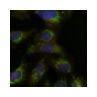

transf


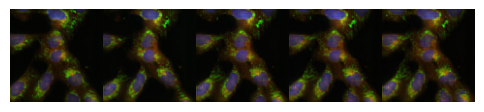

real


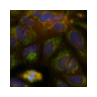

transf


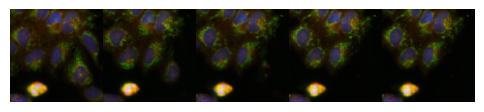

real


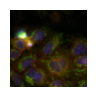

transf


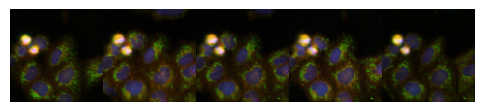

real


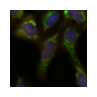

transf


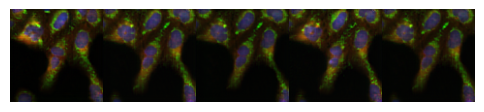

BRD-K18131774-001-18-4
gene --> CA5A
compound --> ethoxzolamide
real


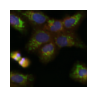

transf


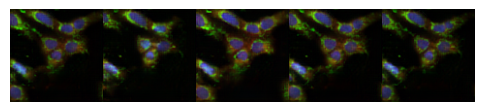

real


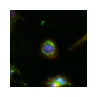

transf


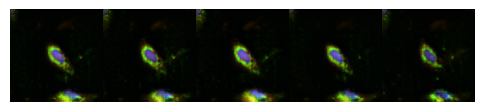

real


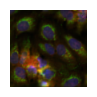

transf


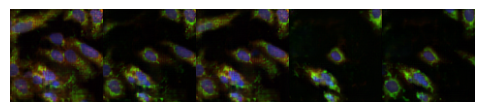

real


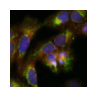

transf


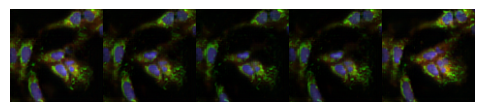

real


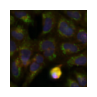

transf


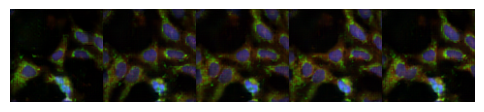

real


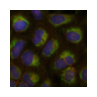

transf


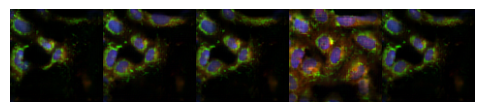

real


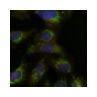

transf


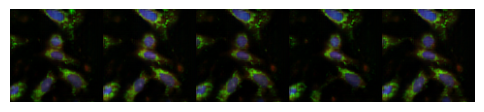

real


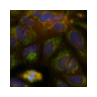

transf


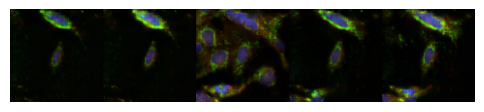

real


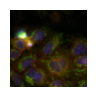

transf


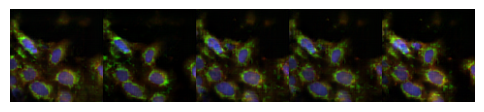

real


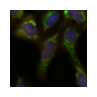

transf


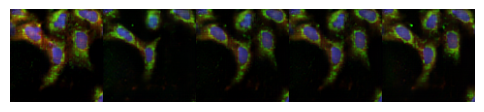

BRD-K14560436-001-01-4
gene --> CDK9
compound --> TG-02
real


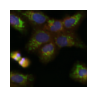

transf


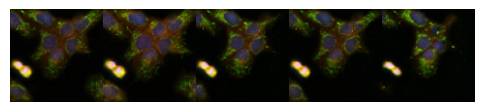

real


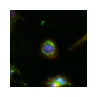

transf


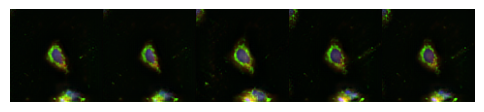

real


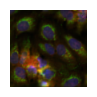

transf


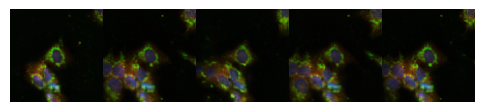

real


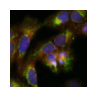

transf


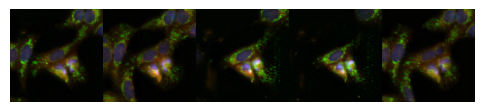

real


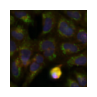

transf


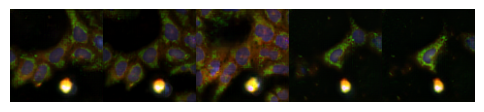

real


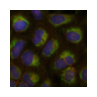

transf


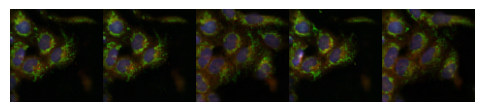

real


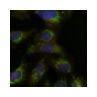

transf


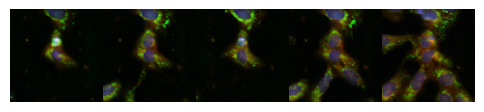

real


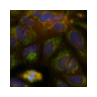

transf


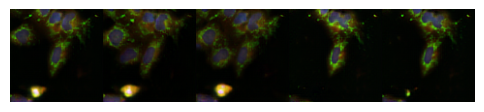

real


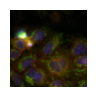

transf


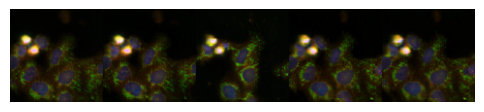

real


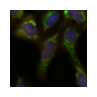

transf


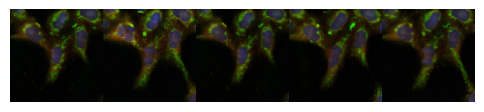

BRD-K43570081-001-02-4
gene --> HSP90AB1
compound --> geldanamycin
real


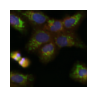

transf


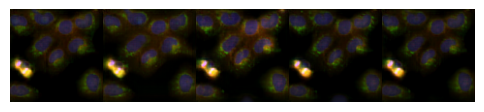

real


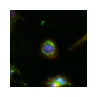

transf


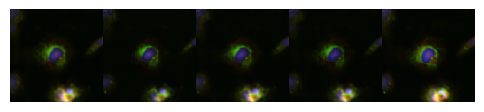

real


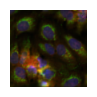

transf


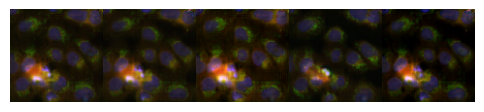

real


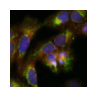

transf


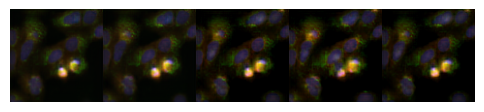

real


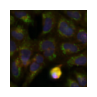

transf


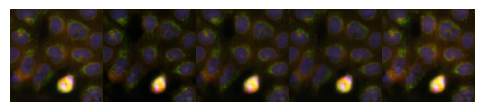

real


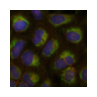

transf


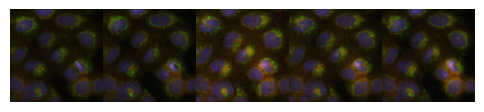

real


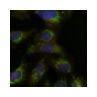

transf


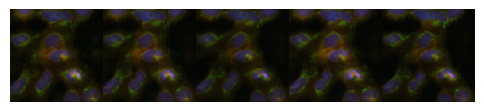

real


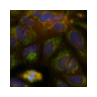

transf


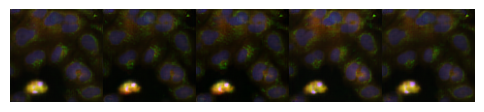

real


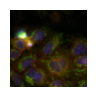

transf


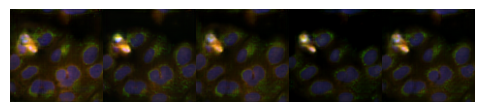

real


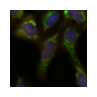

transf


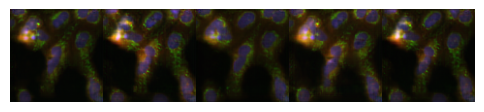

BRD-K54330070-001-19-6
gene --> MAPK14
compound --> SB-202190
real


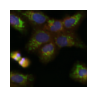

transf


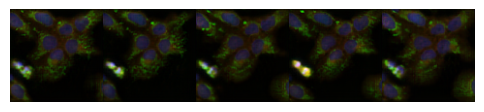

real


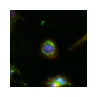

transf


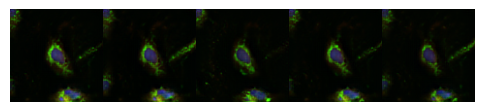

real


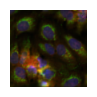

transf


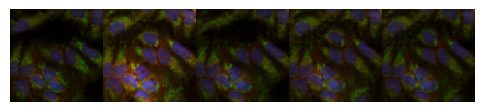

real


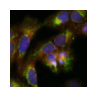

transf


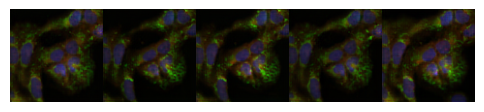

real


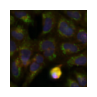

transf


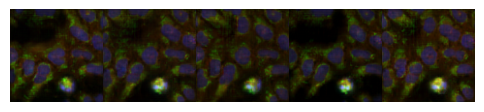

real


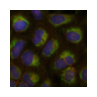

transf


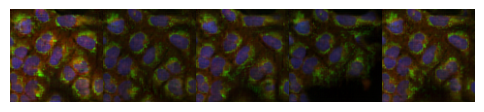

real


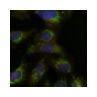

transf


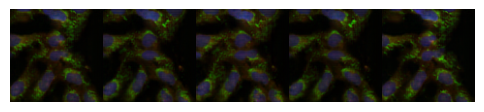

real


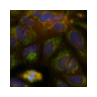

transf


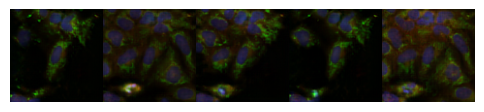

real


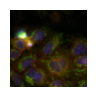

transf


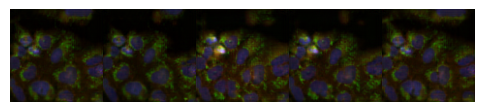

real


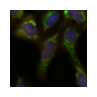

transf


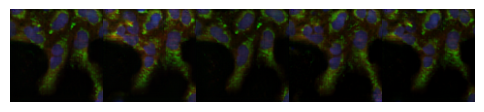

BRD-K40109029-001-02-9
gene --> TGFBR1
compound --> SB-505124
real


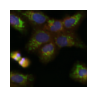

transf


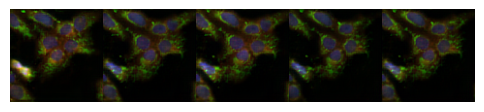

real


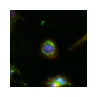

transf


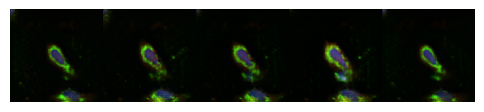

real


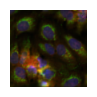

transf


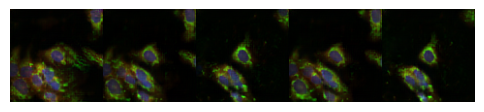

real


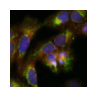

transf


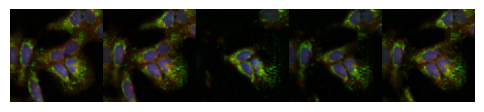

real


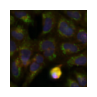

transf


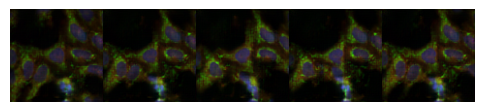

real


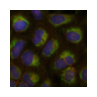

transf


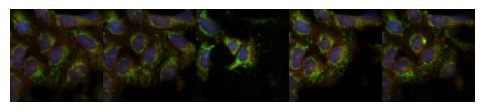

real


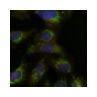

transf


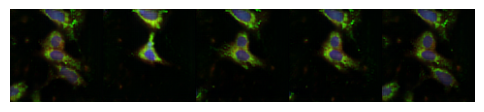

real


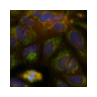

transf


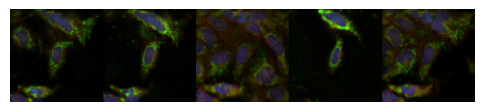

real


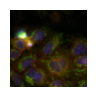

transf


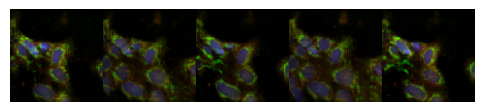

real


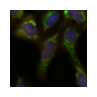

transf


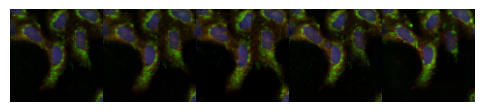

BRD-K00259736-001-16-4
gene --> TUBB3
compound --> colchicine
real


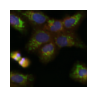

transf


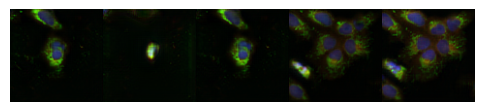

real


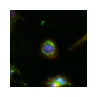

transf


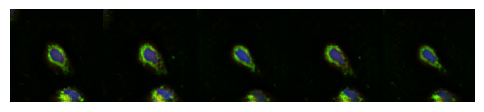

real


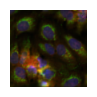

transf


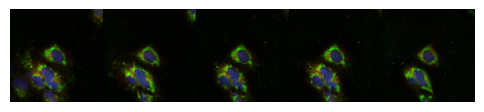

real


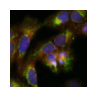

transf


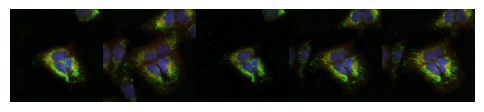

real


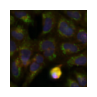

transf


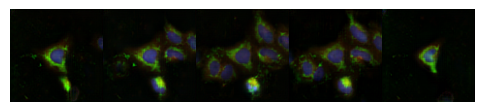

real


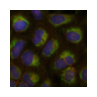

transf


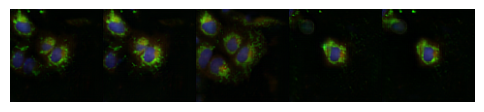

real


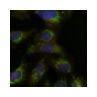

transf


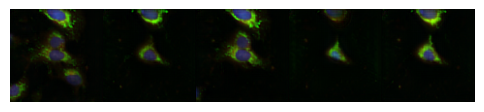

real


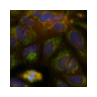

transf


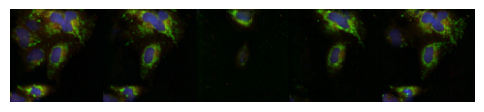

real


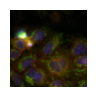

transf


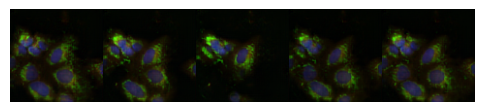

real


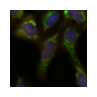

transf


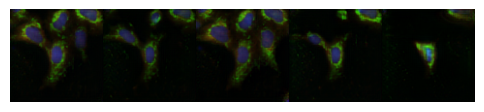

BRD-K03601870-001-01-2
gene --> TUBB4B
compound --> ixabepilone
real


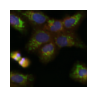

transf


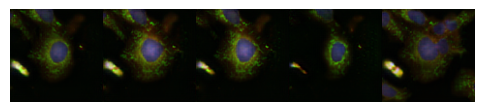

real


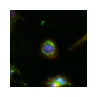

transf


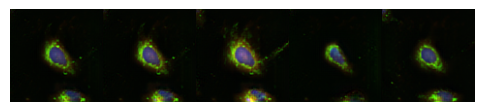

real


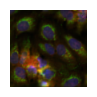

transf


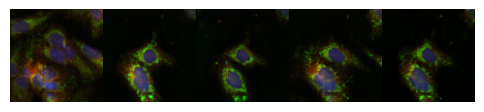

real


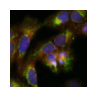

transf


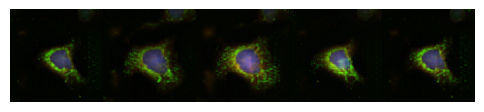

real


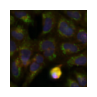

transf


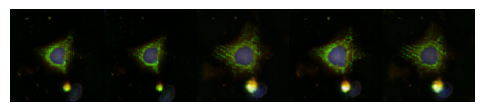

real


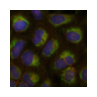

transf


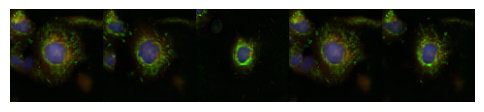

real


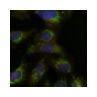

transf


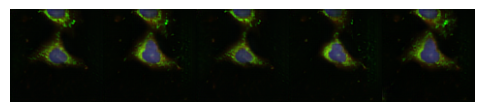

real


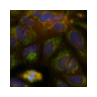

transf


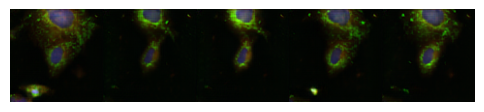

real


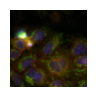

transf


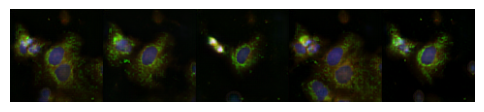

real


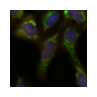

transf


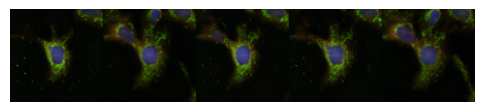

BRD-K18895904-001-16-1
gene --> CHRM2
compound --> olanzapine
real


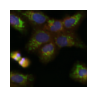

transf


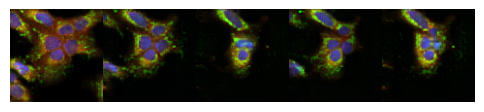

real


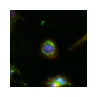

transf


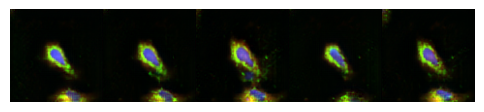

real


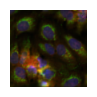

transf


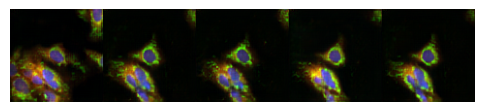

real


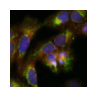

transf


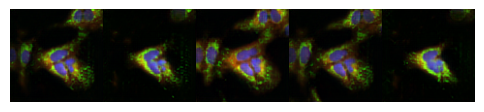

real


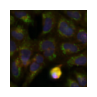

transf


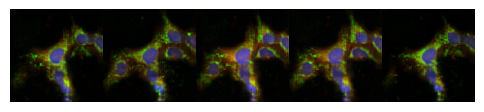

real


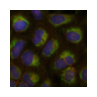

transf


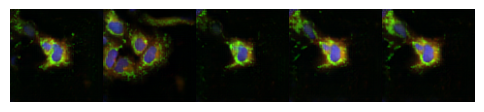

real


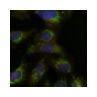

transf


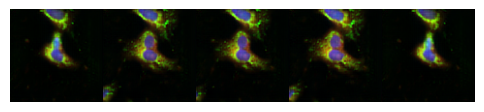

real


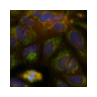

transf


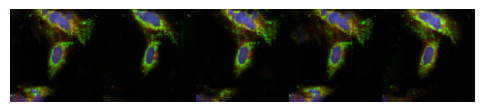

real


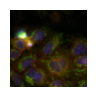

transf


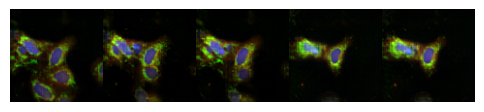

real


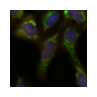

transf


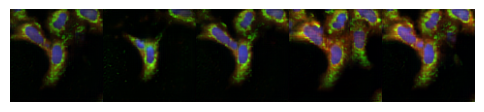

BRD-K15502390-001-20-9
gene --> CYP2A6
compound --> nevirapine
real


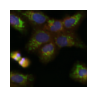

transf


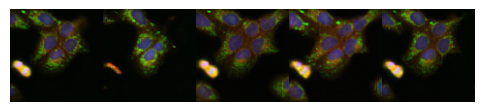

real


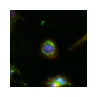

transf


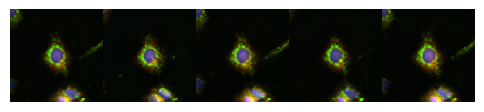

real


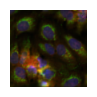

transf


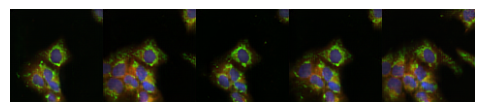

real


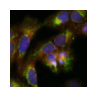

transf


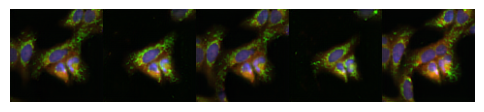

real


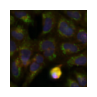

transf


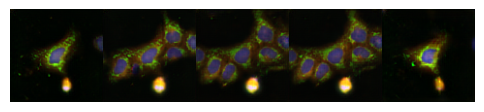

real


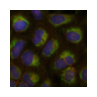

transf


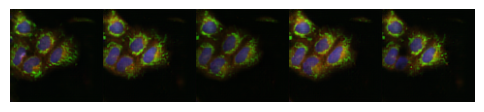

real


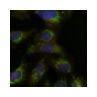

transf


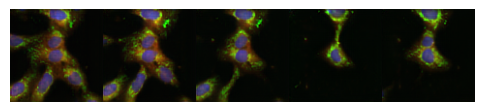

real


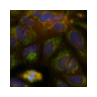

transf


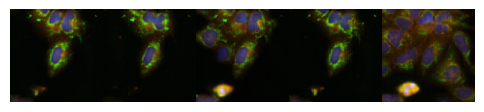

real


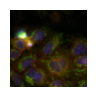

transf


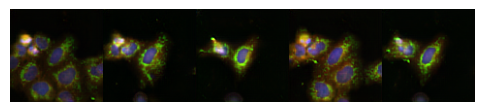

real


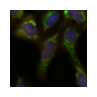

transf


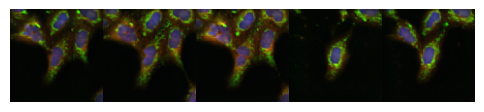

BRD-A20697603-001-07-2
gene --> FOXM1
compound --> thiostrepton
real


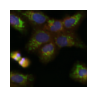

transf


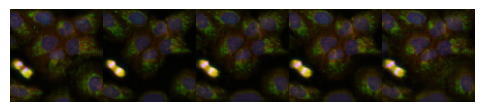

real


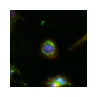

transf


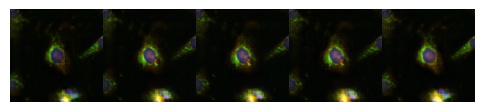

real


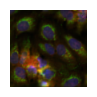

transf


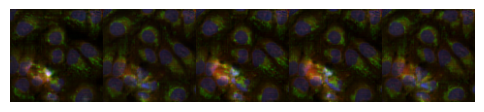

real


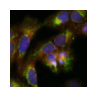

transf


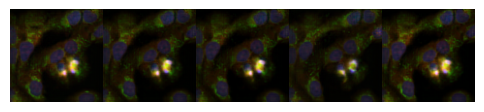

real


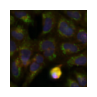

transf


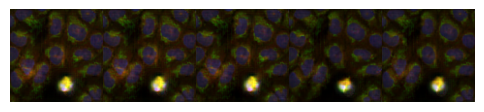

real


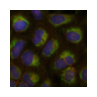

transf


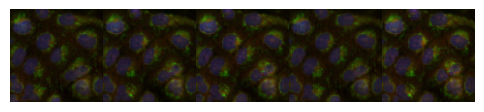

real


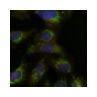

transf


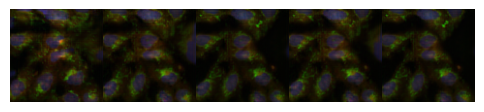

real


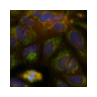

transf


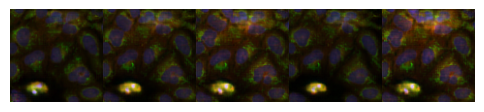

real


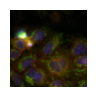

transf


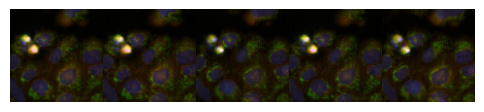

real


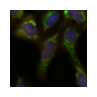

transf


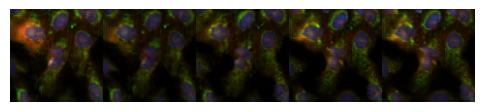

BRD-A08187463-001-12-9
gene --> MME
compound --> racecadotril
real


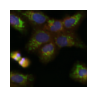

transf


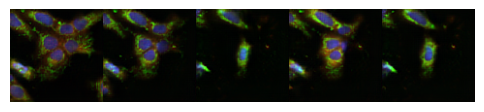

real


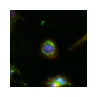

transf


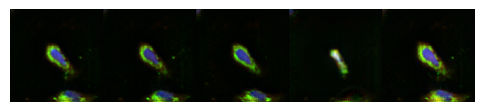

real


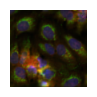

transf


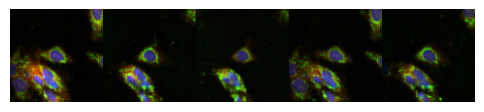

real


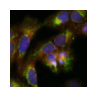

transf


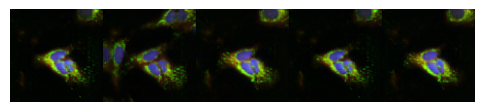

real


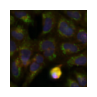

transf


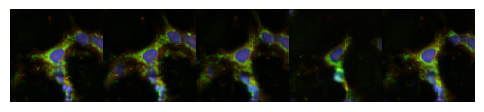

real


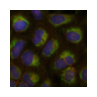

transf


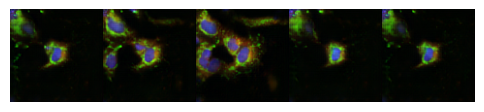

real


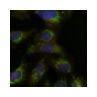

transf


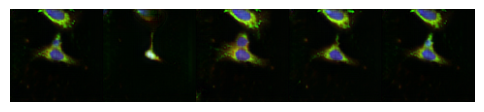

real


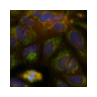

transf


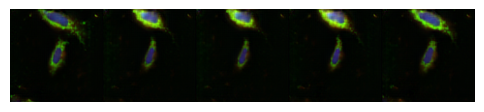

real


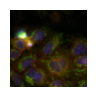

transf


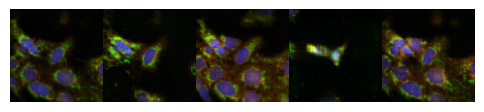

real


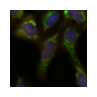

transf


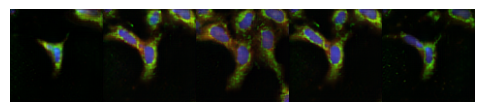

BRD-K03109492-001-02-2
gene --> CDC25A
compound --> NSC-663284
real


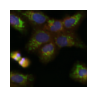

transf


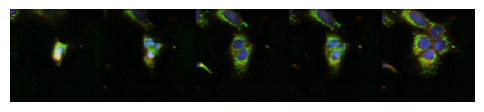

real


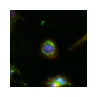

transf


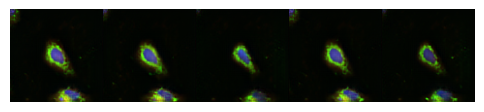

real


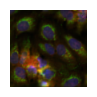

transf


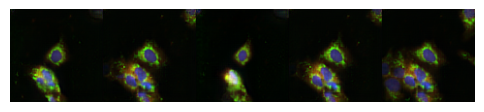

real


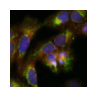

transf


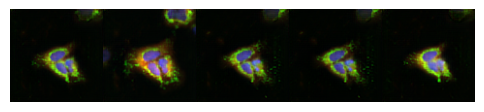

real


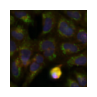

transf


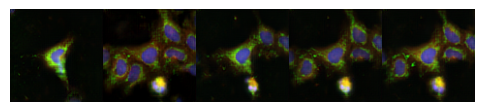

real


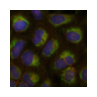

transf


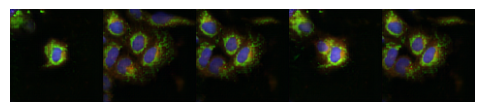

real


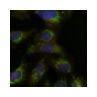

transf


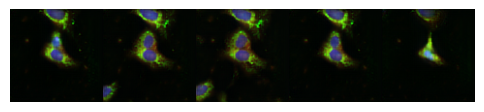

real


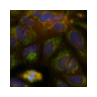

transf


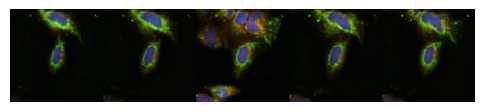

real


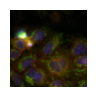

transf


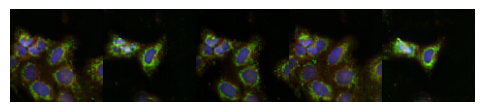

real


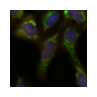

transf


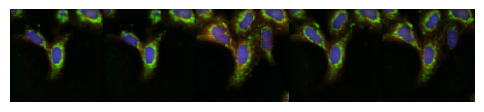

BRDN0001147538
gene --> ABL1
compound --> ABL1
real


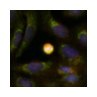

transf


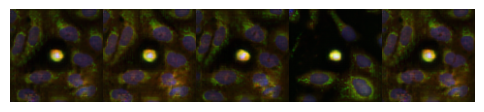

real


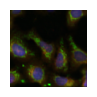

transf


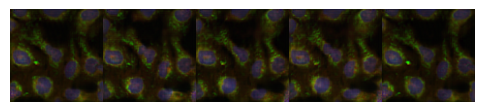

real


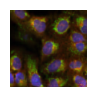

transf


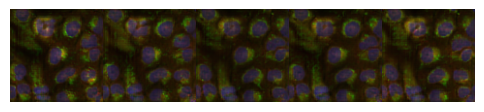

real


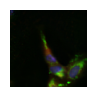

transf


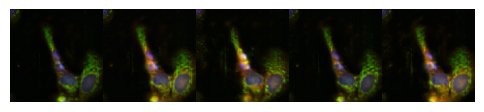

real


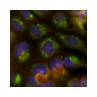

transf


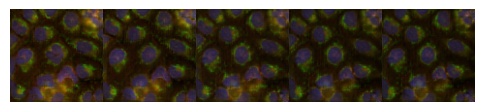

real


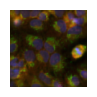

transf


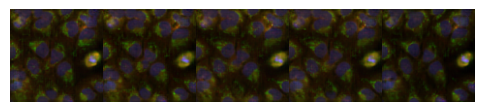

real


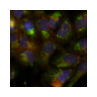

transf


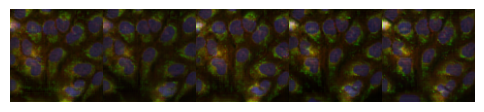

real


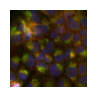

transf


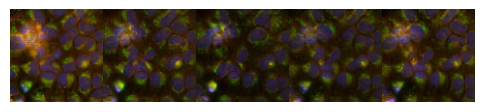

real


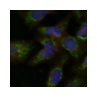

transf


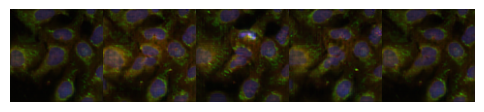

real


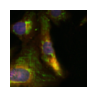

transf


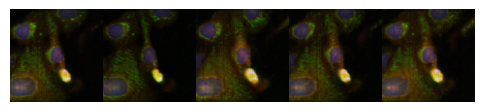

BRDN0001479055
gene --> ALDH2
compound --> ALDH2
real


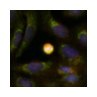

transf


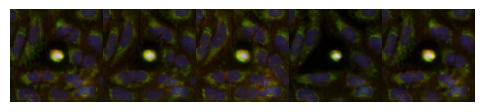

real


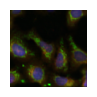

transf


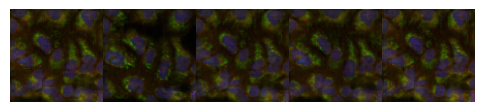

real


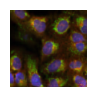

transf


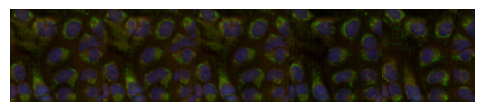

real


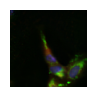

transf


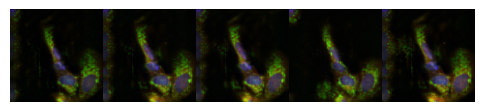

real


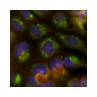

transf


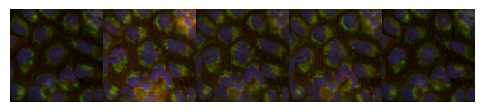

real


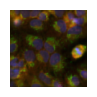

transf


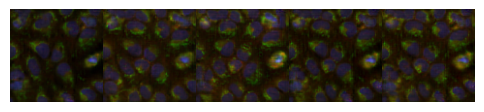

real


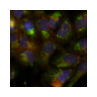

transf


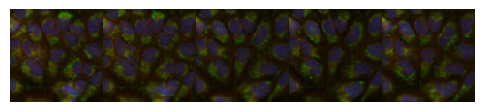

real


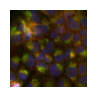

transf


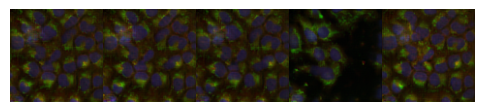

real


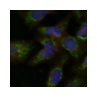

transf


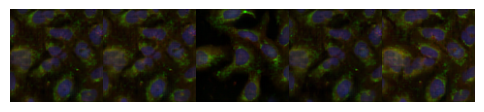

real


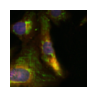

transf


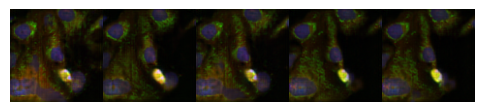

BRDN0001479262
gene --> ADH1C
compound --> ADH1C
real


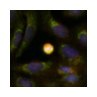

transf


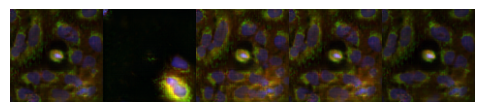

real


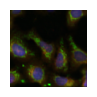

transf


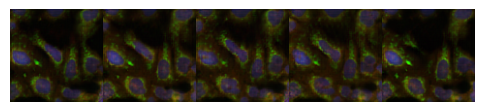

real


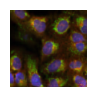

transf


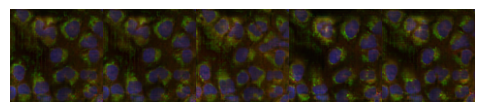

real


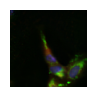

transf


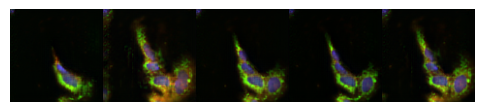

real


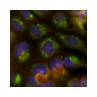

transf


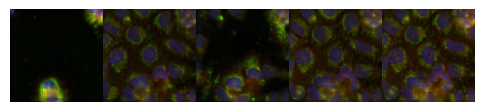

real


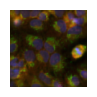

transf


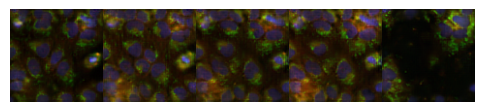

real


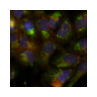

transf


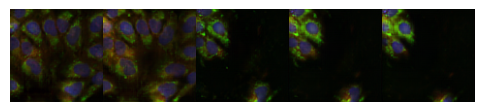

real


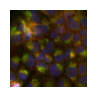

transf


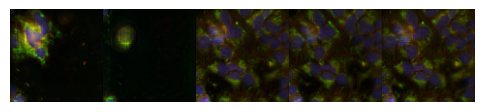

real


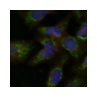

transf


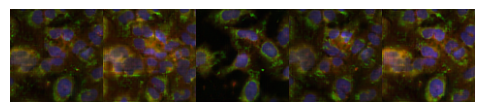

real


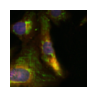

transf


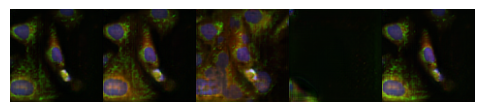

BRDN0001145239
gene --> PDPK1
compound --> PDPK1
real


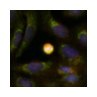

transf


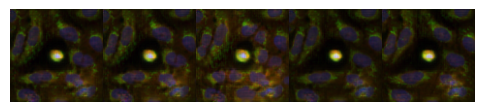

real


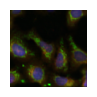

transf


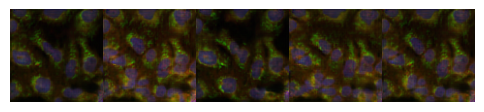

real


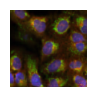

transf


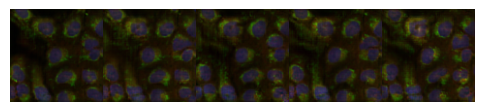

real


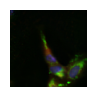

transf


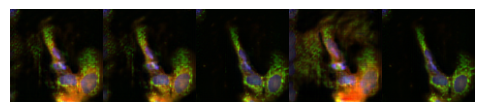

real


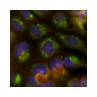

transf


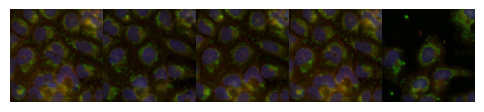

real


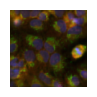

transf


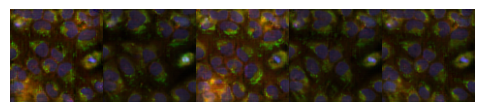

real


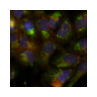

transf


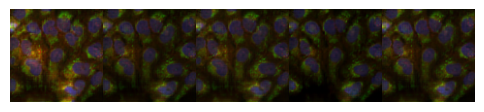

real


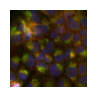

transf


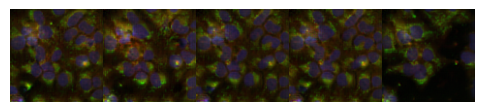

real


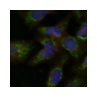

transf


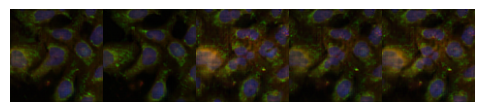

real


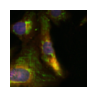

transf


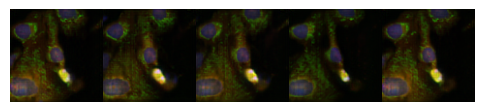

BRDN0001144958
gene --> BTK
compound --> BTK
real


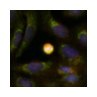

transf


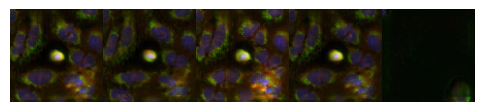

real


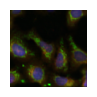

transf


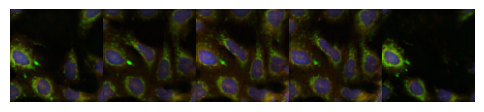

real


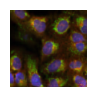

transf


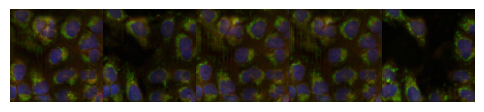

real


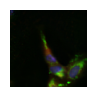

transf


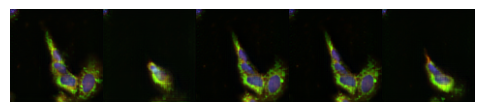

real


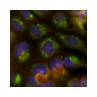

transf


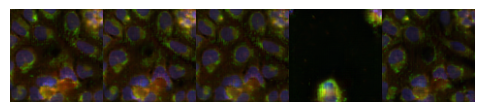

real


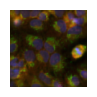

transf


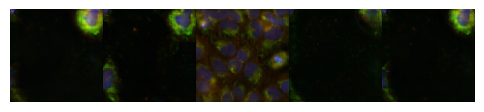

real


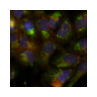

transf


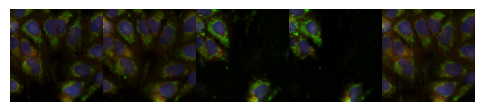

real


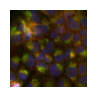

transf


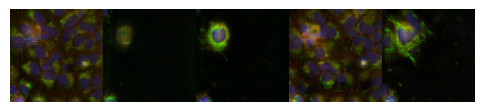

real


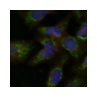

transf


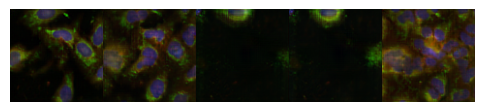

real


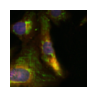

transf


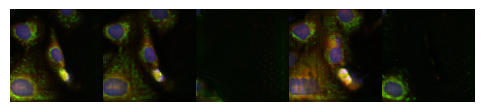

BRDN0001481569
gene --> CYP3A4
compound --> CYP3A4
real


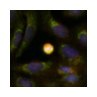

transf


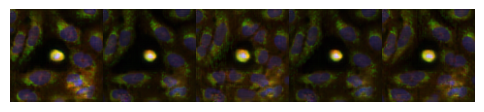

real


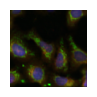

transf


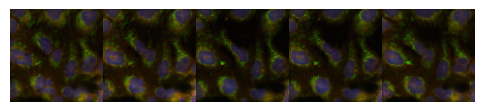

real


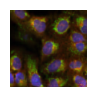

transf


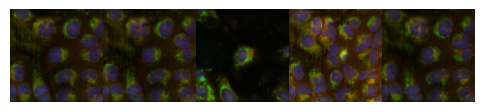

real


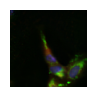

transf


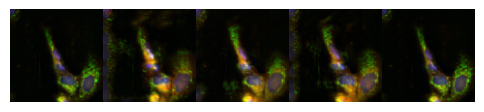

real


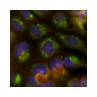

transf


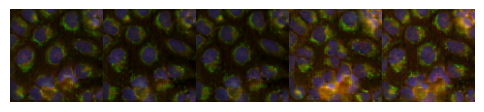

real


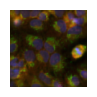

transf


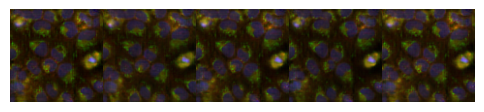

real


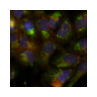

transf


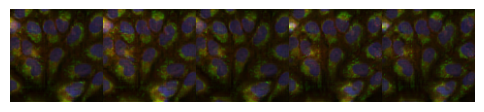

real


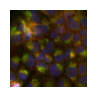

transf


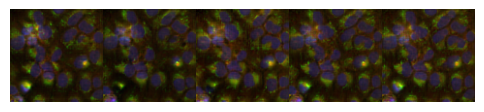

real


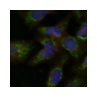

transf


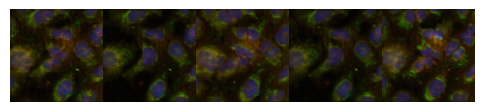

real


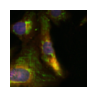

transf


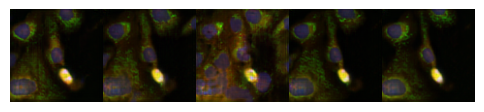

BRDN0001145324
gene --> FLT3
compound --> FLT3
real


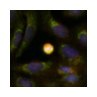

transf


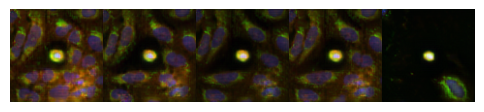

real


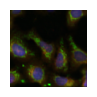

transf


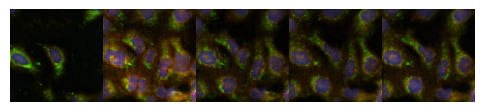

real


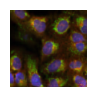

transf


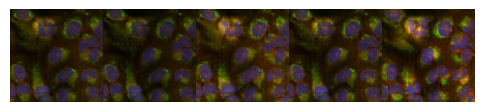

real


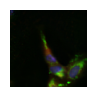

transf


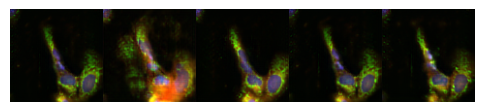

real


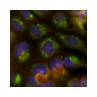

transf


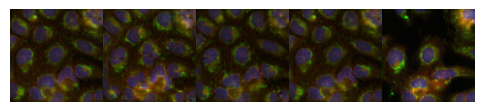

real


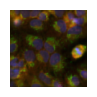

transf


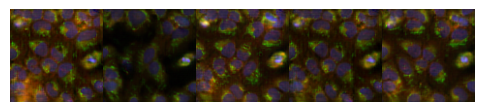

real


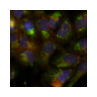

transf


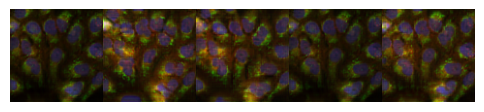

real


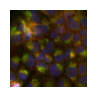

transf


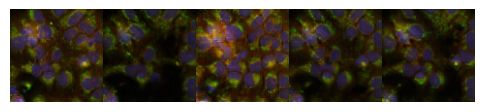

real


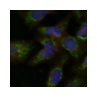

transf


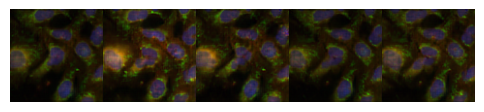

real


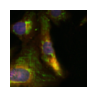

transf


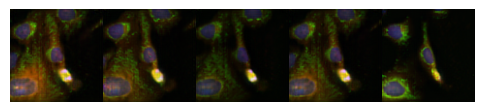

BRDN0001481176
gene --> RPL23A
compound --> RPL23A
real


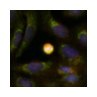

transf


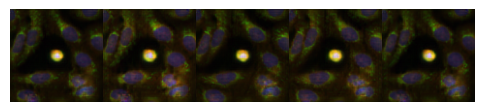

real


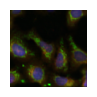

transf


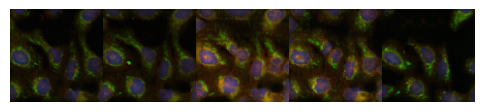

real


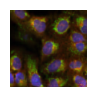

transf


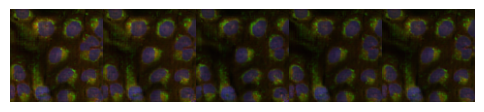

real


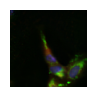

transf


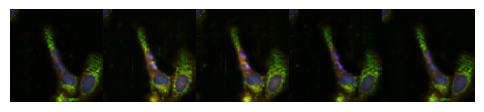

real


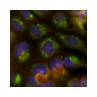

transf


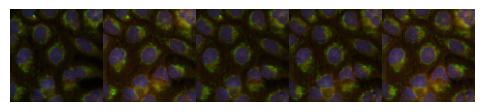

real


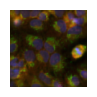

transf


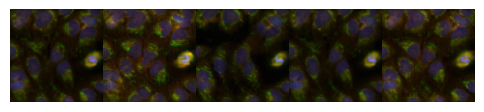

real


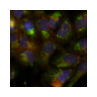

transf


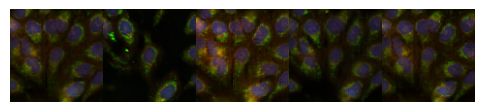

real


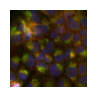

transf


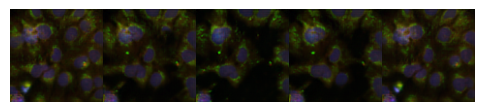

real


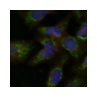

transf


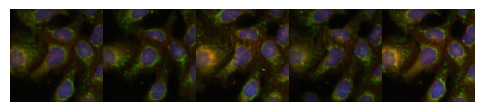

real


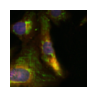

transf


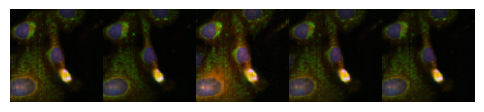

BRDN0001065244
gene --> MAPK8
compound --> MAPK8
real


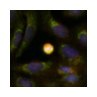

transf


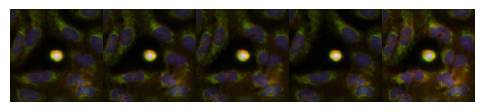

real


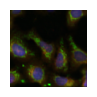

transf


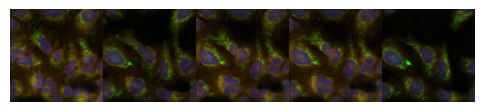

real


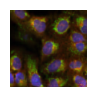

transf


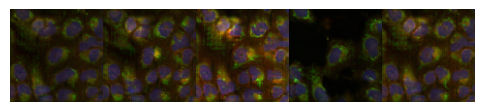

real


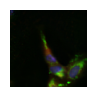

transf


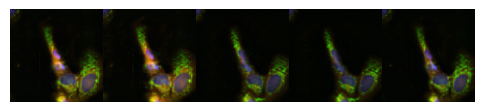

real


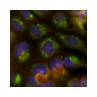

transf


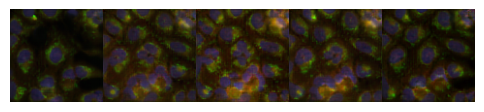

real


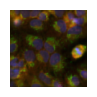

transf


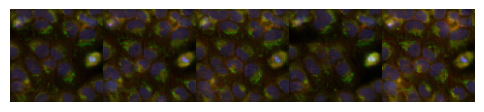

real


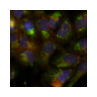

transf


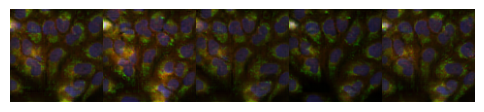

real


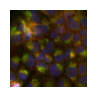

transf


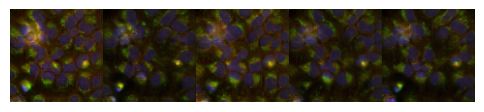

real


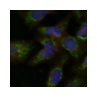

transf


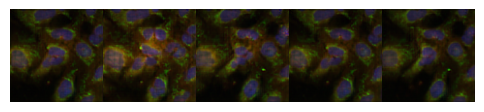

real


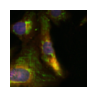

transf


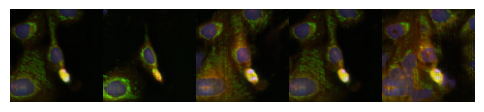

BRDN0001485334
gene --> CA5A
compound --> CA5A
real


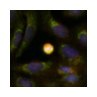

transf


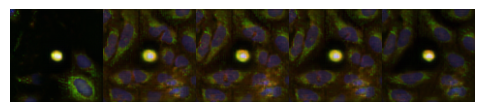

real


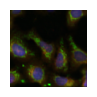

transf


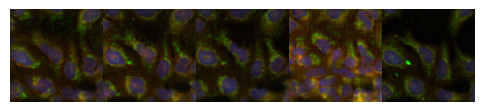

real


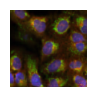

transf


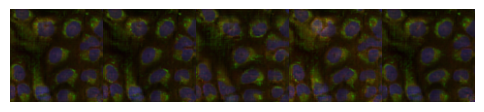

real


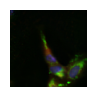

transf


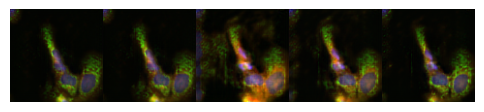

real


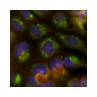

transf


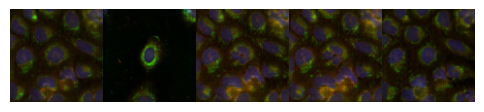

real


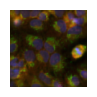

transf


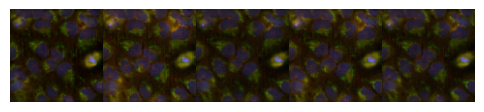

real


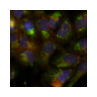

transf


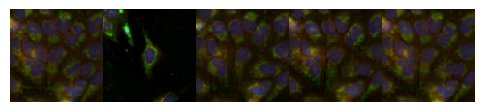

real


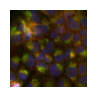

transf


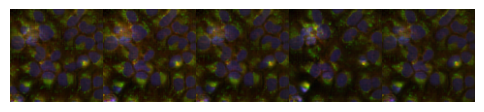

real


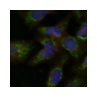

transf


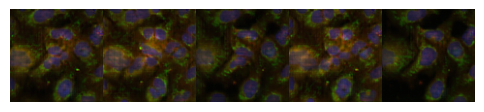

real


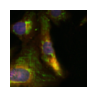

transf


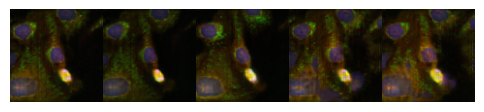

BRDN0001147209
gene --> CLK1
compound --> CLK1
real


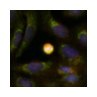

transf


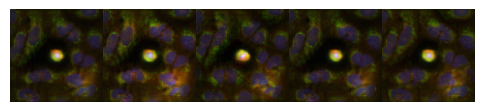

real


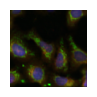

transf


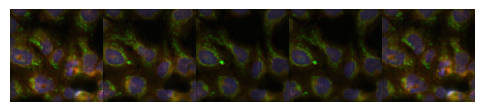

real


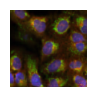

transf


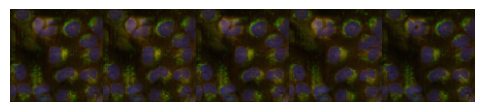

real


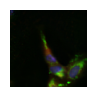

transf


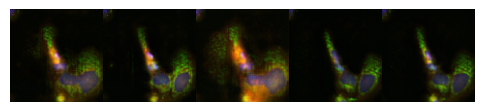

real


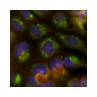

transf


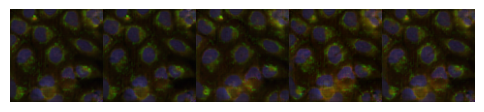

real


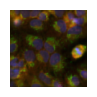

transf


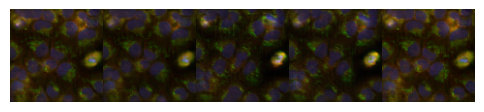

real


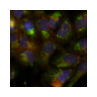

transf


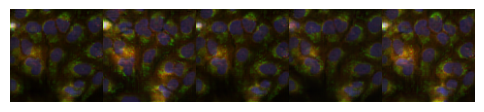

real


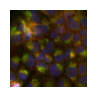

transf


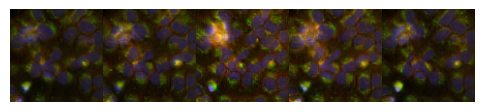

real


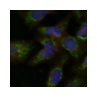

transf


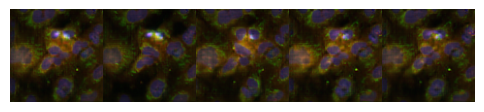

real


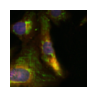

transf


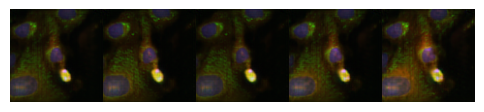

BRDN0001490153
gene --> AVPR1A
compound --> AVPR1A
real


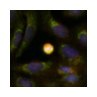

transf


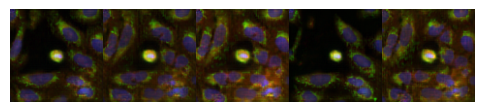

real


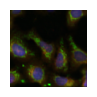

transf


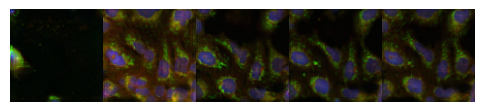

real


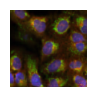

transf


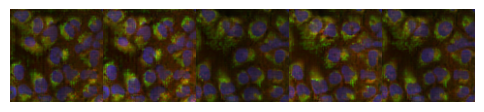

real


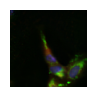

transf


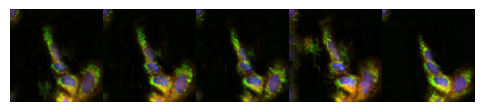

real


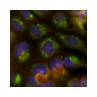

transf


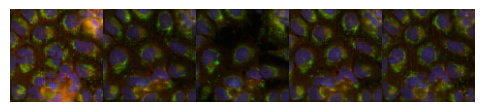

real


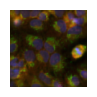

transf


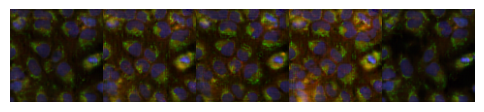

real


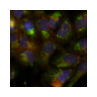

transf


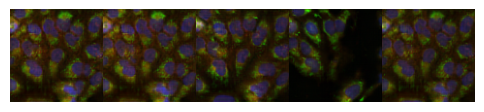

real


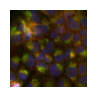

transf


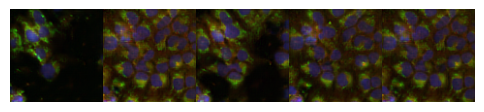

real


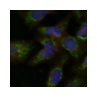

transf


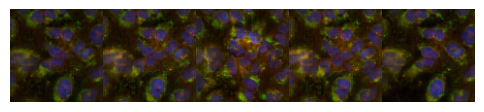

real


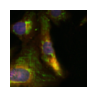

transf


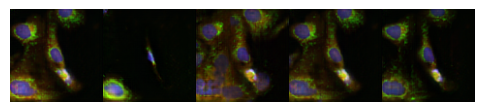

BRDN0001493988
gene --> CDK4
compound --> CDK4
real


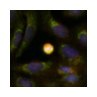

transf


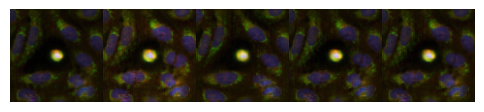

real


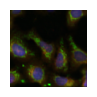

transf


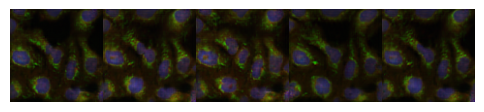

real


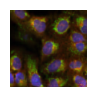

transf


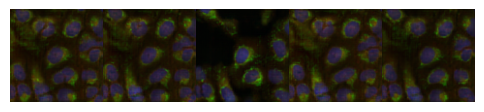

real


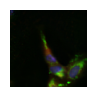

transf


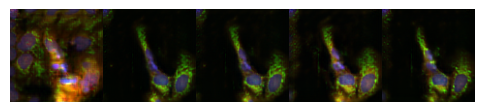

real


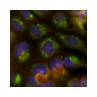

transf


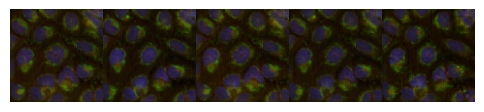

real


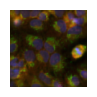

transf


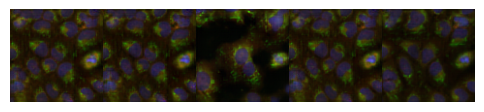

real


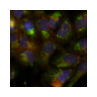

transf


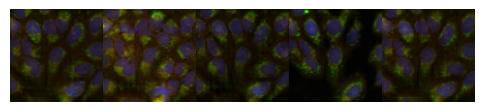

real


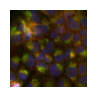

transf


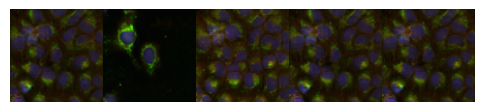

real


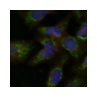

transf


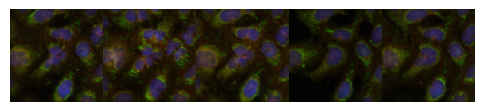

real


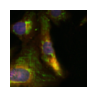

transf


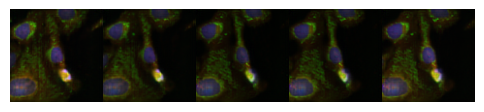

BRDN0001487761
gene --> FGF1
compound --> FGF1
real


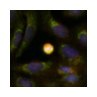

transf


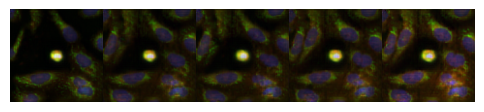

real


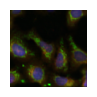

transf


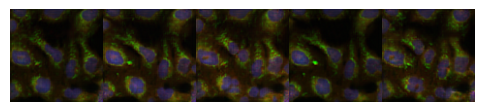

real


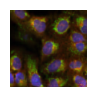

transf


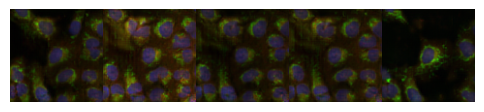

real


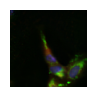

transf


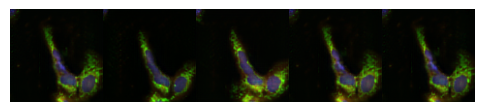

real


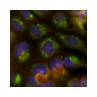

transf


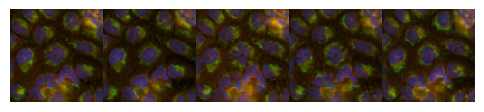

real


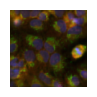

transf


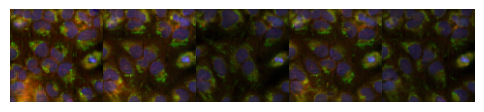

real


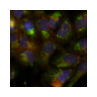

transf


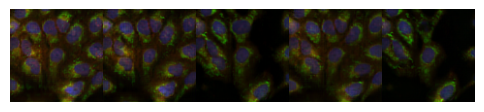

real


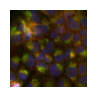

transf


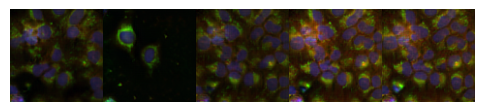

real


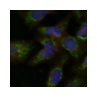

transf


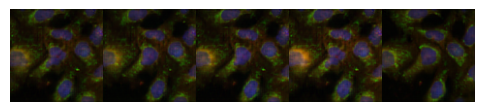

real


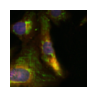

transf


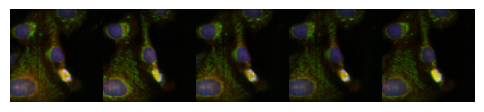

BRDN0001147450
gene --> CDK7
compound --> CDK7
real


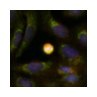

transf


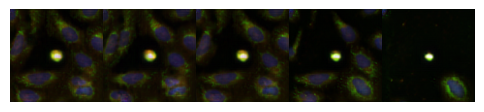

real


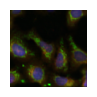

transf


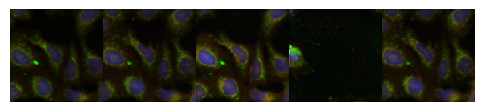

real


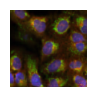

transf


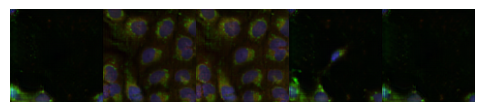

real


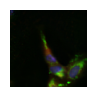

transf


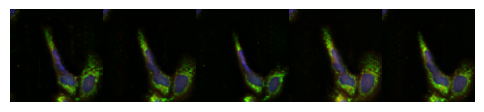

real


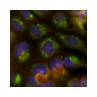

transf


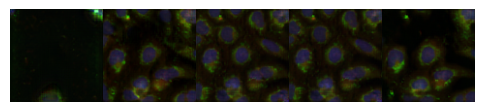

real


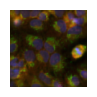

transf


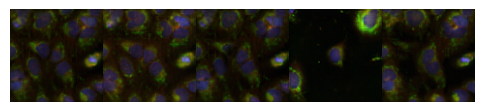

real


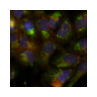

transf


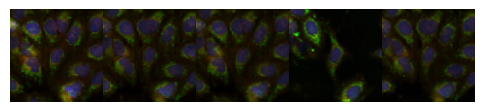

real


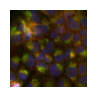

transf


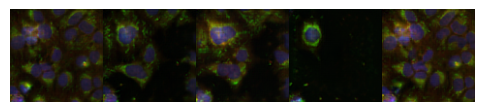

real


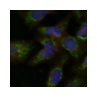

transf


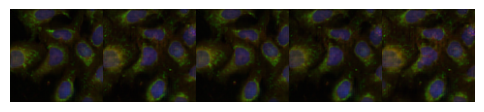

real


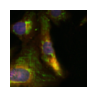

transf


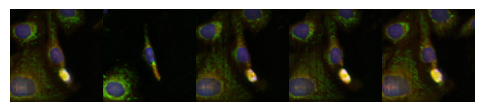

In [186]:
for i, pert in enumerate(transf_images):
    print(pert)
    print("gene -->", genes_heldout[i])
    print("compound -->", pert_id_heldout[i])
    for i in range(10):
        print("real")
        plt.figure(figsize=(1,1))
        plt.imshow(real_images[pert][i][:,:,[0,3,4]])
        plt.axis("off")
        plt.show()
        print("transf")
        plt.figure(figsize=(6,9))
        plt.imshow(transf_images[pert][i][:,:,[0,3,4]])
        plt.axis("off")
        plt.show()  

In [187]:
# data_index = pd.read_csv(args["data_index_path"], index_col=0)
# # data_index_unseen = data_index.loc[data_index.BROAD_SAMPLE.isin(ood_cpd+ood_crispr)]
# data_index_unseen = data_index.loc[data_index.BROAD_SAMPLE.isin(ood_crispr)]
# show_images_by_groups(image_folder, data_index_unseen, "BROAD_SAMPLE", ood_cpd+ood_crispr, 5)

Pert id BRD-K03109492-001-02-2
Plate id BR00117010


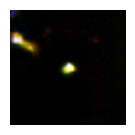

Plate id BR00117013


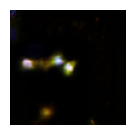

Plate id BR00117012


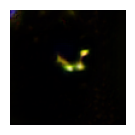

Plate id BR00117013


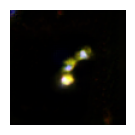

Plate id BR00117010


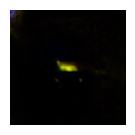

Plate id BR00117013


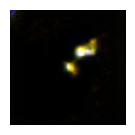

Plate id BR00117013


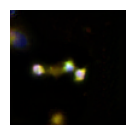

Plate id BR00117012


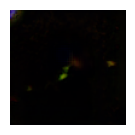

Plate id BR00117010


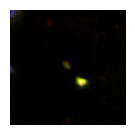

Plate id BR00117013


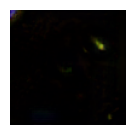

Plate id BR00117011


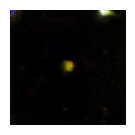

Plate id BR00117010


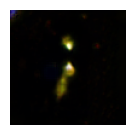

Plate id BR00117011


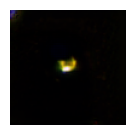

Plate id BR00117010


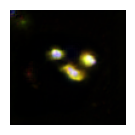

Plate id BR00117010


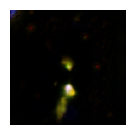

Plate id BR00117011


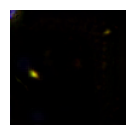

Plate id BR00117012


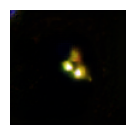

Plate id BR00117010


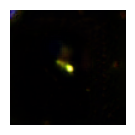

Plate id BR00117013


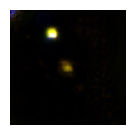

Plate id BR00117010


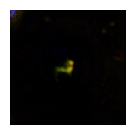

Plate id BR00117011


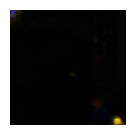

Plate id BR00117010


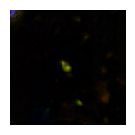

Plate id BR00117010


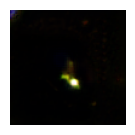

Plate id BR00117012


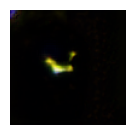

Plate id BR00117013


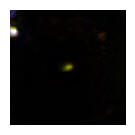

Plate id BR00117011


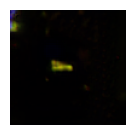

In [188]:
data_index = pd.read_csv(args["data_index_path"], index_col=0)
data_index_unseen = data_index.loc[data_index.BROAD_SAMPLE.isin(ood_cpd+ood_crispr)]
show_images_by_groups(image_folder, data_index, "BROAD_SAMPLE", ["BRD-K03109492-001-02-2"], 50)

Pert id ccsbBroad304_14525
Plate id BR00118040


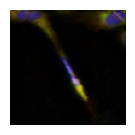

Plate id BR00118039


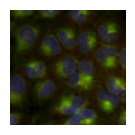

Plate id BR00118039


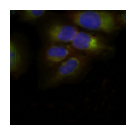

Plate id BR00118040


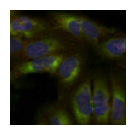

Plate id BR00118040


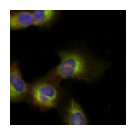

Plate id BR00118040


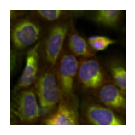

Plate id BR00118040


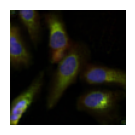

Plate id BR00118039


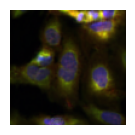

Plate id BR00118039


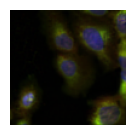

Plate id BR00118039


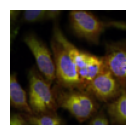

Plate id BR00118039


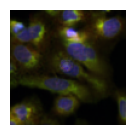

Plate id BR00118039


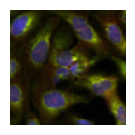

Plate id BR00118040


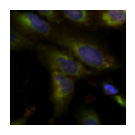

Plate id BR00118039


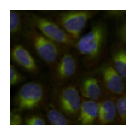

Plate id BR00118039


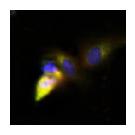

Plate id BR00118040


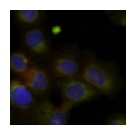

Plate id BR00118039


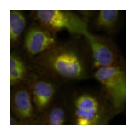

Plate id BR00118039


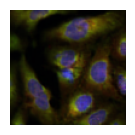

Plate id BR00118040


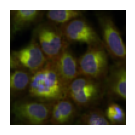

Plate id BR00118040


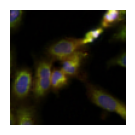

Plate id BR00118039


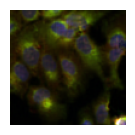

Plate id BR00118039


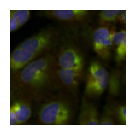

Plate id BR00118040


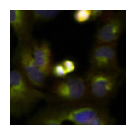

Plate id BR00118040


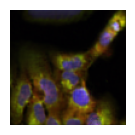

Plate id BR00118040


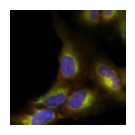

Plate id BR00118040


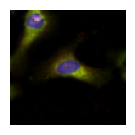

Plate id BR00118039


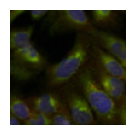

Plate id BR00118040


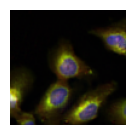

Plate id BR00118040


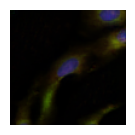

Plate id BR00118039


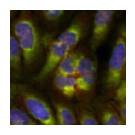

Plate id BR00118039


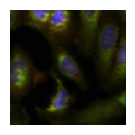

Plate id BR00118039


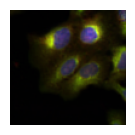

Plate id BR00118040


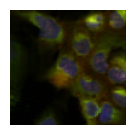

Plate id BR00118040


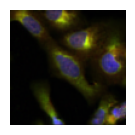

Plate id BR00118040


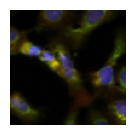

Plate id BR00118040


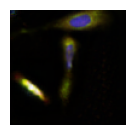

Plate id BR00118039


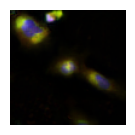

Plate id BR00118039


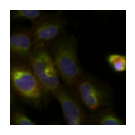

Plate id BR00118040


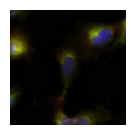

Plate id BR00118039


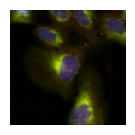

Plate id BR00118039


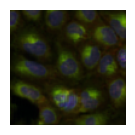

Plate id BR00118039


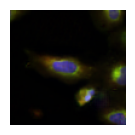

Plate id BR00118040


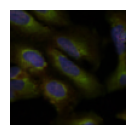

Plate id BR00118039


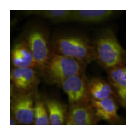

Plate id BR00118040


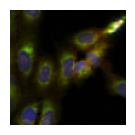

Plate id BR00118039


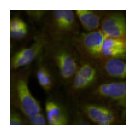

Plate id BR00118040


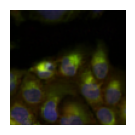

Plate id BR00118040


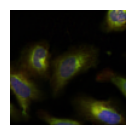

Plate id BR00118039


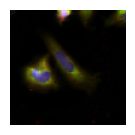

Plate id BR00118039


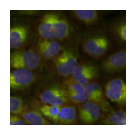

Plate id BR00118040


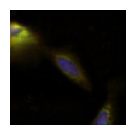

Plate id BR00118039


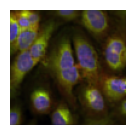

Plate id BR00118039


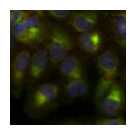

Plate id BR00118039


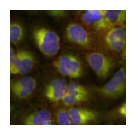

Plate id BR00118040


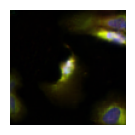

Plate id BR00118039


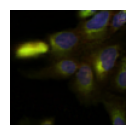

Plate id BR00118039


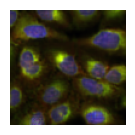

Plate id BR00118039


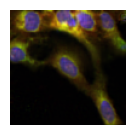

Plate id BR00118039


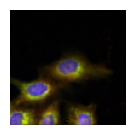

Plate id BR00118039


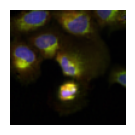

Plate id BR00118039


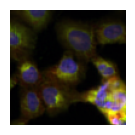

Plate id BR00118039


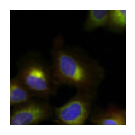

Plate id BR00118040


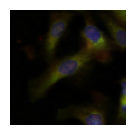

Plate id BR00118039


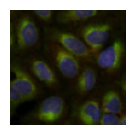

Plate id BR00118040


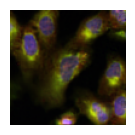

Plate id BR00118039


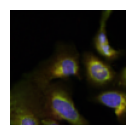

Plate id BR00118040


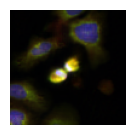

Plate id BR00118040


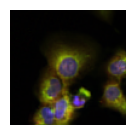

Plate id BR00118040


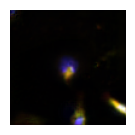

Plate id BR00118039


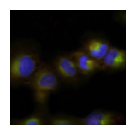

Plate id BR00118040


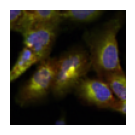

Plate id BR00118039


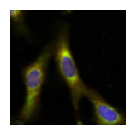

Plate id BR00118040


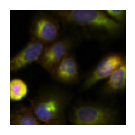

Plate id BR00118039


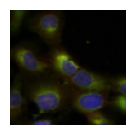

Plate id BR00118039


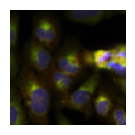

Plate id BR00118039


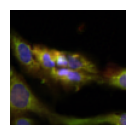

Plate id BR00118039


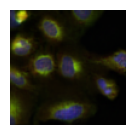

Plate id BR00118040


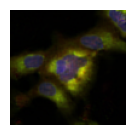

Plate id BR00118039


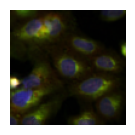

Plate id BR00118039


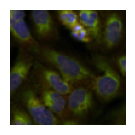

Plate id BR00118040


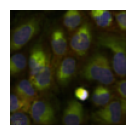

Plate id BR00118040


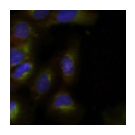

Plate id BR00118040


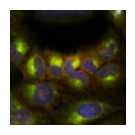

Plate id BR00118039


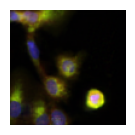

Plate id BR00118040


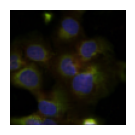

Plate id BR00118039


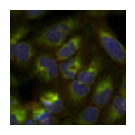

Plate id BR00118040


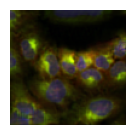

Plate id BR00118039


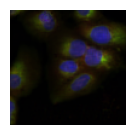

Plate id BR00118039


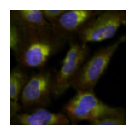

Plate id BR00118039


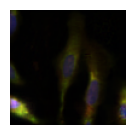

Plate id BR00118039


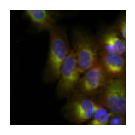

Plate id BR00118040


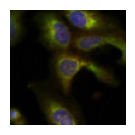

Plate id BR00118039


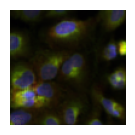

Plate id BR00118039


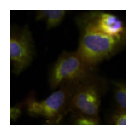

Plate id BR00118039


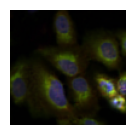

Plate id BR00118040


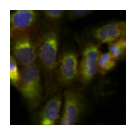

Plate id BR00118039


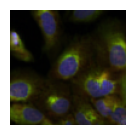

Plate id BR00118040


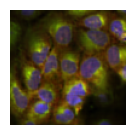

Plate id BR00118039


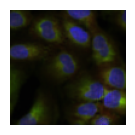

Plate id BR00118039


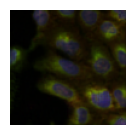

Plate id BR00118039


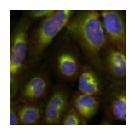

In [189]:
data_index = pd.read_csv(args["data_index_path"], index_col=0)
data_index_unseen = data_index.loc[data_index.BROAD_SAMPLE.isin(ood_cpd+ood_crispr)]
show_images_by_groups(image_folder, data_index, "BROAD_SAMPLE", ["ccsbBroad304_14525"], 100)

In [190]:
data_index.loc[data_index.BROAD_SAMPLE=="BRD-K93788137-001-04-1"]

,BROAD_SAMPLE,SAMPLE_KEY,PLATE,WELL,PERT_TYPE,CPD_NAME,STATE,ANNOT,GENE,SEQUENCE,SPLIT
775,BRD-K93788137-001-04-1,BR00117013_L20_7_16,BR00117013,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
6054,BRD-K93788137-001-04-1,BR00117011_L20_4_15,BR00117011,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
6567,BRD-K93788137-001-04-1,BR00117011_L20_8_7,BR00117011,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
7671,BRD-K93788137-001-04-1,BR00117011_L20_2_7,BR00117011,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
8911,BRD-K93788137-001-04-1,BR00117012_L20_1_11,BR00117012,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
...,...,...,...,...,...,...,...,...,...,...,...
426495,BRD-K93788137-001-04-1,BR00117013_L20_2_8,BR00117013,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
428131,BRD-K93788137-001-04-1,BR00117011_L20_7_12,BR00117011,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train
433015,BRD-K93788137-001-04-1,BR00117011_L20_3_11,BR00117011,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,test
433016,BRD-K93788137-001-04-1,BR00117012_L20_8_13,BR00117012,L20,Compound,PF-431396,trt,Compound,PTK2B,CN(c1ccccc1CNc1nc(Nc2ccc3NC(=O)Cc3c2)ncc1C(F)(...,train


In [191]:
data_index.loc[data_index.BROAD_SAMPLE=="ccsbBroad304_14635"]

,BROAD_SAMPLE,SAMPLE_KEY,PLATE,WELL,PERT_TYPE,CPD_NAME,STATE,ANNOT,GENE,SEQUENCE,SPLIT
4377,ccsbBroad304_14635,BR00118039_J18_3_11,BR00118039,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
5382,ccsbBroad304_14635,BR00118039_J18_1_19,BR00118039,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
9639,ccsbBroad304_14635,BR00118040_J18_9_13,BR00118040,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
10252,ccsbBroad304_14635,BR00118039_J18_6_92,BR00118039,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
10671,ccsbBroad304_14635,BR00118039_J18_8_13,BR00118039,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,test
...,...,...,...,...,...,...,...,...,...,...,...
425523,ccsbBroad304_14635,BR00118040_J18_2_11,BR00118040,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
426710,ccsbBroad304_14635,BR00118039_N19_6_47,BR00118039,N19,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
427690,ccsbBroad304_14635,BR00118039_N19_4_56,BR00118039,N19,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train
430092,ccsbBroad304_14635,BR00118040_J18_4_44,BR00118040,J18,ORF,PTK2B,trt,ORF,PTK2B,atgtctggggtgtccgagcccctgagtcgagtaaagttgggcacgt...,train


## Match real and generated distances from controls

In [192]:
transf_images_fid = {}
control_images_fid = []
genes_heldout_fid = []
pert_id_heldout_fid = []

with torch.no_grad():
    for iter, batch in enumerate(val_dataloader):
        X_ctr = batch["X"][0]
        control_images_fid.append(t2np(X_ctr.detach().cpu()))
        for pert_type in tqdm(held_out_embeddings):
            i = 1 if pert_type=="Compound" else 0    
            for pert in held_out_embeddings[pert_type].index:
                pert_id_heldout.append(np.unique(metadata_cpg0000.loc[metadata_cpg0000.BROAD_SAMPLE==pert].CPD_NAME)[0])
                genes_heldout.append(np.unique(metadata_cpg0000.loc[metadata_cpg0000.BROAD_SAMPLE==pert].GENE)[0])
                emb = torch.Tensor(held_out_embeddings[pert_type].loc[pert]).cuda().unsqueeze(0).repeat(X_ctr.shape[0],1)
                z = torch.randn(X_ctr.shape[0], 1, args.z_dimension).mean(1).cuda()
                
                # Get random vec
                y = torch.cat([emb, z], dim=1)
                y = solver.nets.mapping_network(y, None, i)
                _, X_generated = solver.nets.generator(X_ctr, y)

                if pert not in transf_images_fid:
                    transf_images_fid[pert] = []
                transf_images_fid[pert].append(t2np(X_generated.detach().cpu()))

        if iter==4:
            break

100%|██████████| 2/2 [00:02<00:00,  1.36s/it]


In [193]:
transf_images_fid = {key:np.concatenate(val, axis=0) for key, val in transf_images_fid.items()}
control_images_fid = np.concatenate(control_images_fid, axis=0)
real_images_fid = show_images_by_groups(image_folder, 
                                        data_index_unseen, 
                                        "BROAD_SAMPLE", 
                                        ood_cpd+ood_crispr, 
                                        100,  
                                        plot=False,
                                        save=True)

Pert id BRD-A65597028-003-08-1
Pert id BRD-K90747162-001-01-4
Pert id BRD-K01824976-300-02-9
Pert id BRD-A22713669-001-04-3
Pert id BRD-K76674262-001-03-3
Pert id BRD-A10188456-001-04-9
Pert id BRD-K09295674-001-09-8
Pert id BRD-K18131774-001-18-4
Pert id BRD-K14560436-001-01-4
Pert id BRD-K43570081-001-02-4
Pert id BRD-K54330070-001-19-6
Pert id BRD-K40109029-001-02-9
Pert id BRD-K00259736-001-16-4
Pert id BRD-K03601870-001-01-2
Pert id BRD-K18895904-001-16-1
Pert id BRD-K15502390-001-20-9
Pert id BRD-A20697603-001-07-2
Pert id BRD-A08187463-001-12-9
Pert id BRD-K03109492-001-02-2
Pert id BRDN0001147538
Pert id BRDN0001479055
Pert id BRDN0001479262
Pert id BRDN0001145239
Pert id BRDN0001144958
Pert id BRDN0001481569
Pert id BRDN0001145324
Pert id BRDN0001481176
Pert id BRDN0001065244
Pert id BRDN0001485334
Pert id BRDN0001147209
Pert id BRDN0001490153
Pert id BRDN0001493988
Pert id BRDN0001487761
Pert id BRDN0001147450


In [194]:
scores_fid = {"score_generated_control": [], 
              "score_generated_real": [],
              "score_real_control": [],
              "pert": []}

scores_coverage = {"score_generated_control": [], 
                  "score_generated_real": [],
                  "score_real_control": [],
                  "pert": []}

scores_density= {"score_generated_control": [], 
                  "score_generated_real": [],
                  "score_real_control": [],
                  "pert": []}

for pert in tqdm(transf_images_fid):
    scores_fid["pert"].append(pert)
    scores_coverage["pert"].append(pert)
    scores_density["pert"].append(pert)

    # FID
    fid_generated_control = compute_fid(transf_images_fid[pert], control_images_fid)
    scores_fid["score_generated_control"].append(fid_generated_control)
    fid_generated_real = compute_fid(transf_images_fid[pert], real_images_fid[pert])
    scores_fid["score_generated_real"].append(fid_generated_real)
    fid_real_control = compute_fid(real_images_fid[pert], control_images_fid)
    scores_fid["score_real_control"].append(fid_real_control)

    # Density and Coverage
    dc_generated_control = compute_d_and_c(torch.tensor(transf_images_fid[pert]).contiguous(), 
                                                torch.tensor(control_images_fid).contiguous())
    scores_coverage["score_generated_control"].append(dc_generated_control["coverage"])
    scores_density["score_generated_control"].append(dc_generated_control["density"])
    
    dc_generated_real = compute_d_and_c(torch.tensor(transf_images_fid[pert]).contiguous(), 
                                        torch.tensor(real_images_fid[pert]).contiguous())
    scores_coverage["score_generated_real"].append(dc_generated_real["coverage"])
    scores_density["score_generated_real"].append(dc_generated_real["density"])

    dc_real_control = compute_d_and_c(torch.tensor(real_images_fid[pert]).contiguous(),
                                      torch.tensor(control_images_fid).contiguous())
    scores_coverage["score_real_control"].append(dc_real_control["coverage"])
    scores_density["score_real_control"].append(dc_real_control["density"])
    

  0%|          | 0/34 [00:00<?, ?it/s]/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
  3%|▎         | 1/34 [00:22<12:18, 22.38s/it]/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/s

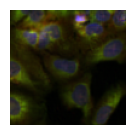

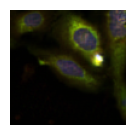

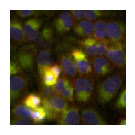

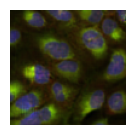

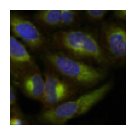

...

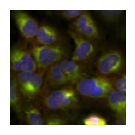

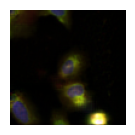

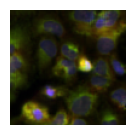

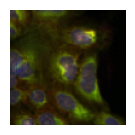

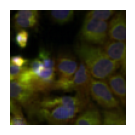

In [195]:
for img in control_images_fid:
    plt.figure(figsize=(1.5, 1.5))
    plt.imshow(img[:,:,[0,1,4]])
    plt.axis("off")
    plt.show()

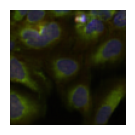

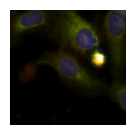

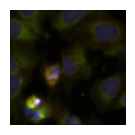

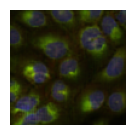

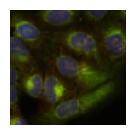

...

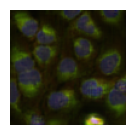

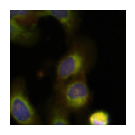

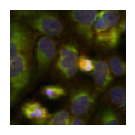

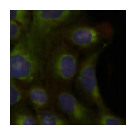

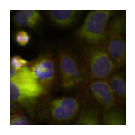

In [196]:
for img in transf_images_fid["BRDN0001481176"]:
    plt.figure(figsize=(1.5, 1.5))
    plt.imshow(img[:,:,[0,1,4]])
    plt.axis("off")
    plt.show()

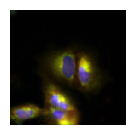

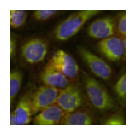

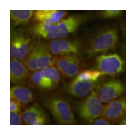

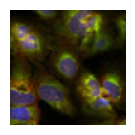

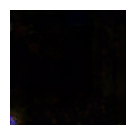

...

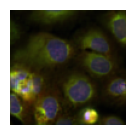

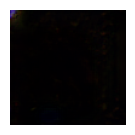

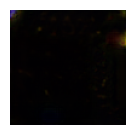

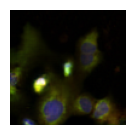

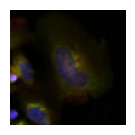

In [197]:
for img in  real_images_fid["BRDN0001481176"]:
    plt.figure(figsize=(1.5, 1.5))
    plt.imshow(img[:,:,[0,1,4]])
    plt.axis("off")
    plt.show()

Transform into dataframe

In [198]:
scores_fid_df = pd.DataFrame(scores_fid)
scores_fid_df

scores_coverage_df = pd.DataFrame(scores_coverage)
scores_coverage_df

scores_density_df = pd.DataFrame(scores_density)
scores_density_df

,score_generated_control,score_generated_real,score_real_control,pert
0,0.622,0.410,1.005941,BRD-A65597028-003-08-1
1,3.250,0.366,1.423762,BRD-K90747162-001-01-4
2,1.692,0.000,2.623529,BRD-K01824976-300-02-9
3,0.546,0.132,1.133333,BRD-A22713669-001-04-3
4,1.358,0.006,1.993443,BRD-K76674262-001-03-3
5,0.888,0.444,1.548515,BRD-A10188456-001-04-9
6,0.466,0.452,0.889109,BRD-K09295674-001-09-8
7,0.380,0.318,0.849505,BRD-K18131774-001-18-4
8,0.696,0.064,1.344304,BRD-K14560436-001-01-4
9,1.910,0.008,1.177778,BRD-K43570081-001-02-4


In [199]:
np.unique(data_index.loc[data_index.BROAD_SAMPLE=="BRDN0001481176"].GENE)

array(['RPL23A'], dtype=object)

Working:
* BRD-A22713669-001-04-3 PTPN2
* BRD-A10188456-001-04-9 ANXA1
* BRD-K09295674-001-09-8 CA14
* BRD-K18131774-001-18-4 CA5A
* BRD-K14560436-001-01-4 CDK9
* BRD-K54330070-001-19-6 MAPK14
* BRD-K40109029-001-02-9 TGFBR1
* BRD-K00259736-001-16-4 TUBB3
* BRD-K03601870-001-01-2 TUBB4B
* BRD-A08187463-001-12-9 MME
* BRD-K03109492-001-02-2 CDC25A

In [200]:
to_keep = ["BRD-A22713669-001-04-3", "BRD-A10188456-001-04-9", "BRD-K09295674-001-09-8", "BRD-K18131774-001-18-4",
          "BRD-K14560436-001-01-4", "BRD-K54330070-001-19-6", "BRD-K40109029-001-02-9", "BRD-K00259736-001-16-4", 
          "BRD-K03601870-001-01-2", "BRD-A08187463-001-12-9", "BRD-K03109492-001-02-2"]

In [201]:
drug_or_crispr = ["drug" if "-" in s else "CRISPR" for s in scores_fid_df.pert]
scores_fid_df["drug_or_crispr"] = drug_or_crispr

In [219]:
scores_fid_df_drug = scores_fid_df.loc[scores_fid_df.drug_or_crispr=="drug"]
scores_fid_df_drug = scores_fid_df_drug.loc[scores_fid_df_drug.pert.isin(to_keep)]
scores_fid_df_crispr = scores_fid_df.loc[scores_fid_df.drug_or_crispr=="CRISPR"]

In [245]:
scores_fid_df_drug.score_generated_control.corr(scores_fid_df_drug.score_real_control)

0.6274063563983023

## Check correlations

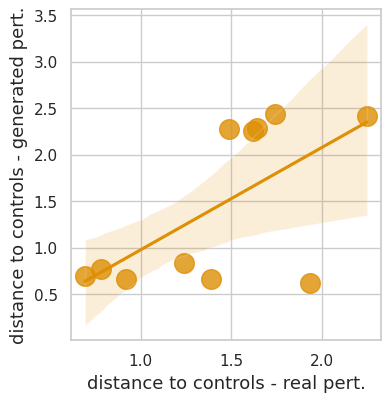

In [221]:
# Plotting the regression plot
sns.set(style="whitegrid")  # Set the style of seaborn plots

plt.figure(figsize=(4,4.3))

# Plotting the regression plot using seaborn
sns.regplot(x='score_generated_control', 
            y='score_real_control', 
            data=scores_fid_df_drug, 
            line_kws=dict(color="#de8f05"), 
            scatter_kws=dict(color="#de8f05", s=200))

# Adding title and labels
# plt.title('Compound')
plt.xlabel('distance to controls - real pert.', fontsize=13)
plt.ylabel('distance to controls - generated pert.', fontsize=13)
plt.savefig('cpd_fid.svg', dpi=300, bbox_inches='tight', format="svg")
# Display the plot
plt.show()

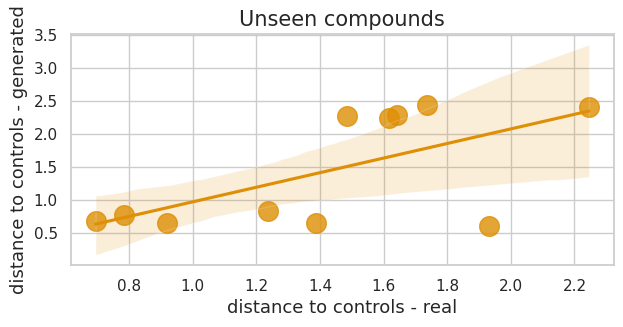

In [246]:
# Plotting the regression plot
sns.set(style="whitegrid")  # Set the style of seaborn plots

plt.figure(figsize=(7,3))

# Plotting the regression plot using seaborn
sns.regplot(x='score_generated_control', 
            y='score_real_control', 
            data=scores_fid_df_drug, 
            line_kws=dict(color="#de8f05"), 
            scatter_kws=dict(color="#de8f05", s=200))

# Adding title and labels
plt.title('Unseen compounds', fontsize=15)
plt.xlabel('distance to controls - real', fontsize=13)
plt.ylabel('distance to controls - generated', fontsize=13)
plt.savefig('cpd_fid.svg', dpi=300, bbox_inches='tight', format="svg")
# Display the plot
plt.show()

In [206]:
scores_fid_df_drug

,score_generated_control,score_generated_real,score_real_control,pert,drug_or_crispr
3,2.245210,1.191986,2.413573,BRD-A22713669-001-04-3,drug
5,0.919401,0.879280,0.658119,BRD-A10188456-001-04-9,drug
6,0.694615,0.632089,0.690349,BRD-K09295674-001-09-8,drug
7,1.387023,1.128110,0.660805,BRD-K18131774-001-18-4,drug
8,1.483811,1.265164,2.271501,BRD-K14560436-001-01-4,drug
10,0.782904,0.840542,0.770076,BRD-K54330070-001-19-6,drug
11,1.236395,0.988924,0.834998,BRD-K40109029-001-02-9,drug
12,1.642303,1.016402,2.286827,BRD-K00259736-001-16-4,drug
13,1.618334,1.136181,2.249083,BRD-K03601870-001-01-2,drug
17,1.931305,1.648223,0.613785,BRD-A08187463-001-12-9,drug


# Coverage versus FID 

In [207]:
df_coverage_fid_crispr = scores_coverage_df.copy()
df_coverage_fid_crispr["drug_or_crispr"] = drug_or_crispr
df_coverage_fid_crispr = df_coverage_fid_crispr.loc[df_coverage_fid_crispr.drug_or_crispr=="CRISPR"]
df_coverage_fid_crispr["fid_score_real_control"] = scores_fid_df_crispr.score_real_control
# df_coverage_fid_crispr= df_coverage_fid_crispr.loc[df_coverage_fid_crispr.pert != 'BRDN0001493988']
df_coverage_fid_crispr= df_coverage_fid_crispr.loc[~df_coverage_fid_crispr.pert.isin(['BRDN0001493988', 'BRDN0001481176',
                                                                                     'BRDN0001144958','BRDN0001065244'])]

In [208]:
df_coverage_fid_crispr

,score_generated_control,score_generated_real,score_real_control,pert,drug_or_crispr,fid_score_real_control
19,1.00,1.000000,0.85,BRDN0001147538,CRISPR,0.623203
20,1.00,1.000000,0.80,BRDN0001479055,CRISPR,0.652454
21,1.00,0.940594,0.99,BRDN0001479262,CRISPR,0.564002
22,1.00,1.000000,0.96,BRDN0001145239,CRISPR,0.570966
24,1.00,1.000000,1.00,BRDN0001481569,CRISPR,0.577157
25,1.00,1.000000,0.84,BRDN0001145324,CRISPR,0.564048
28,1.00,1.000000,0.94,BRDN0001485334,CRISPR,0.529361
29,1.00,1.000000,0.85,BRDN0001147209,CRISPR,0.530586
30,0.98,0.980198,0.87,BRDN0001490153,CRISPR,0.530574
32,1.00,1.000000,0.99,BRDN0001487761,CRISPR,0.539326


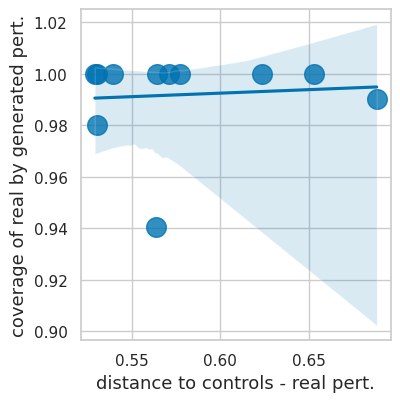

In [209]:
sns.set(style="whitegrid")

plt.figure(figsize=(4, 4.3))

# Plotting the regression plot using seaborn
sns.regplot(x='fid_score_real_control',
           y='score_generated_real', 
           data=df_coverage_fid_crispr,
           ci=99, 
           line_kws=dict(color="#0173b2"), 
           scatter_kws=dict(color="#0173b2", s=200))

# Adding title and labels
# plt.title('CRISPR')
plt.ylabel('coverage of real by generated pert.', fontsize=13)
plt.xlabel('distance to controls - real pert.', fontsize=13)

# Set x-axis tick labels format to two decimal places
# plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.2f}'.format(x)))

# Save the plot as an SVG file
plt.savefig('crispr_coverage.svg', dpi=300, bbox_inches='tight', format="svg")

# Display the plot
plt.show()

In [210]:
scores_fid_df_crispr
scores_fid_df_crispr2 = scores_fid_df_crispr.loc[~scores_fid_df_crispr.pert.isin(['BRDN0001493988', 'BRDN0001481176'])]
scores_fid_df_crispr2

,score_generated_control,score_generated_real,score_real_control,pert,drug_or_crispr
19,0.647189,0.662384,0.623203,BRDN0001147538,CRISPR
20,0.828281,0.705005,0.652454,BRDN0001479055,CRISPR
21,0.845163,0.922217,0.564002,BRDN0001479262,CRISPR
22,0.678515,0.657741,0.570966,BRDN0001145239,CRISPR
23,0.811033,0.722809,0.679293,BRDN0001144958,CRISPR
24,0.654710,0.554227,0.577157,BRDN0001481569,CRISPR
25,0.637001,0.627380,0.564048,BRDN0001145324,CRISPR
27,0.647741,0.790802,0.662147,BRDN0001065244,CRISPR
28,0.741517,0.614355,0.529361,BRDN0001485334,CRISPR
29,0.673408,0.602374,0.530586,BRDN0001147209,CRISPR


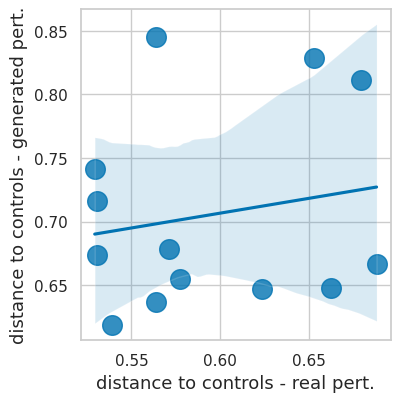

In [211]:
sns.set(style="whitegrid")

plt.figure(figsize=(4, 4.3))

# Plotting the regression plot using seaborn
sns.regplot(x='score_real_control',
           y='score_generated_control', 
           data=scores_fid_df_crispr2,
           ci=99, 
           line_kws=dict(color="#0173b2"), 
           scatter_kws=dict(color="#0173b2", s=200))

# Adding title and labels
# plt.title('CRISPR')
plt.xlabel('distance to controls - real pert.', fontsize=13)
plt.ylabel('distance to controls - generated pert.', fontsize=13)

# Set x-axis tick labels format to two decimal places
# plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.2f}'.format(x)))

In [212]:
np.corrcoef(scores_fid_df_crispr2.score_real_control, scores_fid_df_crispr2.score_generated_control)

array([[1.        , 0.18006466],
       [0.18006466, 1.        ]])

In [213]:
np.corrcoef(scores_fid_df_drug.score_real_control, scores_fid_df_drug.score_generated_control)

array([[1.        , 0.62740636],
       [0.62740636, 1.        ]])